In [1]:
#导入包
import anndata
print('anndata(Ver): ',anndata.__version__)
import scanpy as sc
print('scanpy(Ver): ',sc.__version__)
import matplotlib.pyplot as plt
import matplotlib
print('matplotlib(Ver): ',matplotlib.__version__)
import seaborn as sns
print('seaborn(Ver): ',sns.__version__)
import numpy as np
print('numpy(Ver): ',np.__version__)
import pandas as pd
print('pandas(Ver): ',pd.__version__)
import scvelo as scv
print('scvelo(Ver): ',scv.__version__)
import Pyomic
print('Pyomic(Ver): ',Pyomic.__version__)
import pyVIA.core as via
#print('pyVIA(Ver): ',via.__version__)


#绘图参数设置
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.set_figure_params(dpi=80, facecolor='white')

from matplotlib.colors import LinearSegmentedColormap
sc_color=['#7CBB5F','#368650','#A499CC','#5E4D9A','#78C2ED','#866017', '#9F987F','#E0DFED',
 '#EF7B77', '#279AD7','#F0EEF0', '#1F577B', '#A56BA7', '#E0A7C8', '#E069A6', '#941456', '#FCBC10',
 '#EAEFC5', '#01A0A7', '#75C8CC', '#F0D7BC', '#D5B26C', '#D5DA48', '#B6B812', '#9DC3C3', '#A89C92', '#FEE00C', '#FEF2A1']
sc_color_cmap = LinearSegmentedColormap.from_list('Custom', sc_color, len(sc_color))

anndata(Ver):  0.8.0
scanpy(Ver):  1.9.1
matplotlib(Ver):  3.5.1
seaborn(Ver):  0.11.2
numpy(Ver):  1.22.3
pandas(Ver):  1.3.5
scvelo(Ver):  0.2.4
Pyomic(Ver):  1.1.4
/home/leihu/pyomic/lib/python3.8/site-packages/phate/__init__.py


In [4]:
from pyVIA.utils_via import *
from pyVIA.plotting_via import *
def draw_piechart_graph(adata,clusters,via_object, type_data='pt', gene_exp:list=[], title='', cmap:str=None, ax_text=True, dpi=150,headwidth_arrow = 0.1, alpha_edge=0.4, linewidth_edge=2, edge_color='darkblue',reference=None, show_legend:bool=True, pie_size_scale:float=0.8, fontsize:float=8):
    '''
    plot two subplots with a clustergraph level representation of the viagraph showing true-label composition (lhs) and pseudotime/gene expression (rhs)
    Returns matplotlib figure with two axes that plot the clustergraph using edge bundling
    left axis shows the clustergraph with each node colored by annotated ground truth membership.
    right axis shows the same clustergraph with each node colored by the pseudotime or gene expression
    :param via_object: is class VIA (the same function also exists as a method of the class and an external plotting function
    :param type_data: string  default 'pt' for pseudotime colored nodes. or 'gene'
    :param gene_exp: list of values (column of dataframe) corresponding to feature or gene expression to be used to color nodes at CLUSTER level
    :param title: string
    :param cmap: default None. automatically chooses coolwarm for gene expression or viridis_r for pseudotime
    :param ax_text: Bool default= True. Annotates each node with cluster number and population of membership
    :param dpi: int default = 150
    :param headwidth_bundle: default = 0.1. width of arrowhead used to directed edges
    :param reference: None or list. list of categorical (str) labels for cluster composition of the piecharts (LHS subplot) length = n_samples.
    :param pie_size_scale: float default=0.8 scaling factor of the piechart nodes
    :return: f, ax, ax1
    '''

    from mpl_toolkits.axes_grid1 import make_axes_locatable
    f, ((ax, ax1)) = plt.subplots(1, 2, sharey=True, dpi=dpi)

    node_pos = via_object.graph_node_pos

    node_pos = np.asarray(node_pos)
    if cmap is None: cmap = 'coolwarm' if type_data == 'gene' else 'viridis_r'

    if type_data == 'pt':
        pt = via_object.scaled_hitting_times  # these are the final MCMC refined pt then slightly scaled at cluster level
        title_ax1 = "Pseudotime"

    if type_data == 'gene':
        pt = gene_exp
        title_ax1 = title
    if reference is None: reference_labels=via_object.true_label
    else: reference_labels = reference
    n_groups = len(set(via_object.labels))
    n_truegroups = len(set(reference_labels))
    group_pop = np.zeros([n_groups, 1])
    group_frac = pd.DataFrame(np.zeros([n_groups, n_truegroups]), columns=list(adata.obs[clusters].cat.categories))
    via_object.cluster_population_dict = {}
    for group_i in set(via_object.labels):
        loc_i = np.where(via_object.labels == group_i)[0]

        group_pop[group_i] = len(loc_i)  # np.sum(loc_i) / 1000 + 1
        via_object.cluster_population_dict[group_i] = len(loc_i)
        true_label_in_group_i = list(np.asarray(reference_labels)[loc_i])
        for ii in set(true_label_in_group_i):
            group_frac[ii][group_i] = true_label_in_group_i.count(ii)

    line_true = np.linspace(0, 1, n_truegroups)
    color_true_list = [plt.cm.rainbow(color) for color in line_true]
    color_true_list=adata.uns['{}_colors'.format(clusters)]

    sct = ax.scatter(node_pos[:, 0], node_pos[:, 1],
                     c='white', edgecolors='face', s=group_pop, cmap='jet')

    bboxes = getbb(sct, ax)

    ax = plot_edgebundle_viagraph(ax, via_object.hammerbundle_cluster, layout=via_object.graph_node_pos, CSM=via_object.CSM,
                            velocity_weight=via_object.velo_weight, pt=pt, headwidth_bundle=headwidth_arrow,
                            alpha_bundle=alpha_edge,linewidth_bundle=linewidth_edge, edge_color=edge_color)

    trans = ax.transData.transform
    bbox = ax.get_position().get_points()
    ax_x_min = bbox[0, 0]
    ax_x_max = bbox[1, 0]
    ax_y_min = bbox[0, 1]
    ax_y_max = bbox[1, 1]
    ax_len_x = ax_x_max - ax_x_min
    ax_len_y = ax_y_max - ax_y_min
    trans2 = ax.transAxes.inverted().transform
    pie_axs = []
    pie_size_ar = ((group_pop - np.min(group_pop)) / (np.max(group_pop) - np.min(group_pop)) + 0.5) / 10  # 10

    for node_i in range(n_groups):

        cluster_i_loc = np.where(np.asarray(via_object.labels) == node_i)[0]
        majority_true = via_object.func_mode(list(np.asarray(reference_labels)[cluster_i_loc]))
        pie_size = pie_size_ar[node_i][0] *pie_size_scale

        x1, y1 = trans(node_pos[node_i])  # data coordinates
        xa, ya = trans2((x1, y1))  # axis coordinates

        xa = ax_x_min + (xa - pie_size / 2) * ax_len_x
        ya = ax_y_min + (ya - pie_size / 2) * ax_len_y
        # clip, the fruchterman layout sometimes places below figure
        if ya < 0: ya = 0
        if xa < 0: xa = 0
        rect = [xa, ya, pie_size * ax_len_x, pie_size * ax_len_y]
        frac = np.asarray([ff for ff in group_frac.iloc[node_i].values])

        pie_axs.append(plt.axes(rect, frameon=False))
        pie_axs[node_i].pie(frac, wedgeprops={'linewidth': 0.0}, colors=color_true_list)
        pie_axs[node_i].set_xticks([])
        pie_axs[node_i].set_yticks([])
        pie_axs[node_i].set_aspect('equal')
        # pie_axs[node_i].text(0.5, 0.5, graph_node_label[node_i])
        if ax_text==True: pie_axs[node_i].text(0.5, 0.5, majority_true, fontsize = fontsize )

    patches, texts = pie_axs[node_i].pie(frac, wedgeprops={'linewidth': 0.0}, colors=color_true_list)
    labels = list(set(reference_labels))
    if show_legend ==True: plt.legend(patches, labels, loc=(-5, -5), fontsize=6, frameon=False)

    if via_object.time_series==True:
        ti = 'Cluster Composition. K=' + str(via_object.knn) + '. ncomp = ' + str(via_object.ncomp)  +'knnseq_'+str(via_object.knn_sequential)# "+ is_sub
    else:
        ti = 'Cluster Composition. K=' + str(via_object.knn) + '. ncomp = ' + str(via_object.ncomp)
    ax.set_title(ti)
    ax.grid(False)
    ax.set_xticks([])
    ax.set_yticks([])

    title_list = [title_ax1]
    for i, ax_i in enumerate([ax1]):
        pt = via_object.markov_hitting_times if type_data == 'pt' else gene_exp

        c_edge, l_width = [], []
        for ei, pti in enumerate(pt):
            if ei in via_object.terminal_clusters:
                c_edge.append('red')
                l_width.append(1.5)
            else:
                c_edge.append('gray')
                l_width.append(0.0)

        gp_scaling = 1000 / max(group_pop)

        group_pop_scale = group_pop * gp_scaling * 0.5
        ax_i=plot_edgebundle_viagraph(ax_i, via_object.hammerbundle_cluster, layout=via_object.graph_node_pos,CSM=via_object.CSM, velocity_weight=via_object.velo_weight, pt=pt,headwidth_bundle=headwidth_arrow, alpha_bundle=alpha_edge, linewidth_bundle=linewidth_edge, edge_color=edge_color)

        im1 = ax_i.scatter(node_pos[:, 0], node_pos[:, 1], s=group_pop_scale, c=pt, cmap=cmap,
                           edgecolors=c_edge,
                           alpha=1, zorder=3, linewidth=l_width)
        if ax_text:
            x_max_range = np.amax(node_pos[:, 0]) / 100
            y_max_range = np.amax(node_pos[:, 1]) / 100

            for ii in range(node_pos.shape[0]):
                ax_i.text(node_pos[ii, 0] + max(x_max_range, y_max_range),
                          node_pos[ii, 1] + min(x_max_range, y_max_range),
                          'C' + str(ii) + 'pop' + str(int(group_pop[ii][0])),
                          color='black', zorder=4, fontsize = fontsize)
        ax_i.set_title(title_list[i])
        ax_i.grid(False)
        ax_i.set_xticks([])
        ax_i.set_yticks([])

    divider = make_axes_locatable(ax1)
    cax = divider.append_axes('right', size='5%', pad=0.05)
    if type_data == 'pt':
        f.colorbar(im1, cax=cax, orientation='vertical', label='pseudotime',shrink=0.5)
    else:
        f.colorbar(im1, cax=cax, orientation='vertical', label='Gene expression',shrink=0.5)
    f.patch.set_visible(False)

    ax1.axis('off')
    ax.axis('off')
    ax.set_facecolor('white')
    ax1.set_facecolor('white')
    return f, ax, ax1

In [3]:
rna=sc.read('data/rna_anno_new.h5ad')
rna

AnnData object with n_obs × n_vars = 20037 × 2000
    obs: 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'SRR', 'Cancer', 'Tissue', 'Developmental_Stage', 'sample', 'Type', 'n_genes', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'domain', 'leiden', 'SRR1', 'balancing_weight', 'n_counts', 'major_celltype', 'major_celltype_new'
    var: 'gene_ids', 'feature_types', 'genome', 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std', 'chrom', 'chromStart', 'chromEnd', 'name', 'score', 'strand', 'thickStart', 'thickEnd', 'itemRgb', 'blockCount', 'blockSizes', 'blockStarts', 'gene_id', 'gene_type', 'hgnc_id', 'havana_gene', 'tag', 'dell', 'dispersions', 'dispersions_norm'
    uns: 'Cancer_colors', 'Developmental_Stage_color

In [4]:
# create a dictionary to map cluster to annotation label
cluster2annotation = {
     '0': 'Photoreceptor cells',
     '1': 'Photoreceptor cells',
     '2': 'Müller glia cells',#Germ-cell(Oid)
     '3': 'Photoreceptor cells',#Germ-cell(Oid)
     '4': 'STER cells',
     '5': 'Astrocytes',
     '6': 'Retinal stem cells',
     '7': 'Photoreceptor progenitor cell',
     '8': 'STER cells',
     '9': 'Photoreceptor cells',
     '10': 'Astrocytes',#Germ-cell(Oid)
     '11': 'Photoreceptor progenitor cell',
     '12': 'Müller glia cells',
     '13': 'Müller glia cells',
     '14': 'Müller glia cells',
     '15': 'STER cells',#Germ
     '16': 'Photoreceptor cells',#plasma
     '17': 'Lymphocytes',#plasma
     '18': 'Müller glia cells',
     '19': 'Müller glia cells',
     '20': 'Retinal pigment epithelium (RPE) cells',#Germ-cell(Oid)
     '21': 'STER cells',
     '22': 'Müller glia cells',
     '23': 'Müller glia cells',



}
rna.obs['major_celltype'] = rna.obs['leiden'].map(cluster2annotation).astype('category')

In [5]:
rna.obs['major_celltype_new']=rna.obs['major_celltype']
rna.obs['major_celltype_new']=rna.obs['major_celltype_new'].astype('str')
rna.obs.loc[rna.obs['major_celltype']=='Retinal pigment epithelium (RPE) cells','major_celltype_new']='RPE cells'
rna.obs.loc[rna.obs['major_celltype']=='Retinal progenitor cells (RPCs)','major_celltype_new']='RPCs'
rna.obs.loc[rna.obs['major_celltype']=='Photoreceptor progenitor cell','major_celltype_new']='P-Photoreceptor cells'
rna.obs['major_celltype_new']=rna.obs['major_celltype_new'].astype('category')

In [6]:
rna.obs['major_celltype_new'].unique()

['Müller glia cells', 'Astrocytes', 'P-Photoreceptor cells', 'Photoreceptor cells', 'Retinal stem cells', 'Lymphocytes', 'STER cells', 'RPE cells']
Categories (8, object): ['Astrocytes', 'Lymphocytes', 'Müller glia cells', 'P-Photoreceptor cells', 'Photoreceptor cells', 'RPE cells', 'Retinal stem cells', 'STER cells']

In [7]:
adata=rna[rna.obs['major_celltype_new'].isin(['P-Photoreceptor cells', 'Photoreceptor cells','Retinal stem cells', 'STER cells'])]
adata

View of AnnData object with n_obs × n_vars = 13161 × 2000
    obs: 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'SRR', 'Cancer', 'Tissue', 'Developmental_Stage', 'sample', 'Type', 'n_genes', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'domain', 'leiden', 'SRR1', 'balancing_weight', 'n_counts', 'major_celltype', 'major_celltype_new'
    var: 'gene_ids', 'feature_types', 'genome', 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std', 'chrom', 'chromStart', 'chromEnd', 'name', 'score', 'strand', 'thickStart', 'thickEnd', 'itemRgb', 'blockCount', 'blockSizes', 'blockStarts', 'gene_id', 'gene_type', 'hgnc_id', 'havana_gene', 'tag', 'dell', 'dispersions', 'dispersions_norm'
    uns: 'Cancer_colors', 'Developmental_Sta

In [8]:
sc.tl.pca(adata, n_comps=100, svd_solver="arpack")

#scv.pl.velocity_embedding_stream(adata, basis='umap',color=['major_celltype','leiden','Type'])

computing PCA
    on highly variable genes
    with n_comps=100
    finished (0:00:06)


computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)
running Leiden clustering
    finished: found 21 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:01)
running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:00)
--> added 'pos', the PAGA positions (adata.uns['paga'])
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:12)


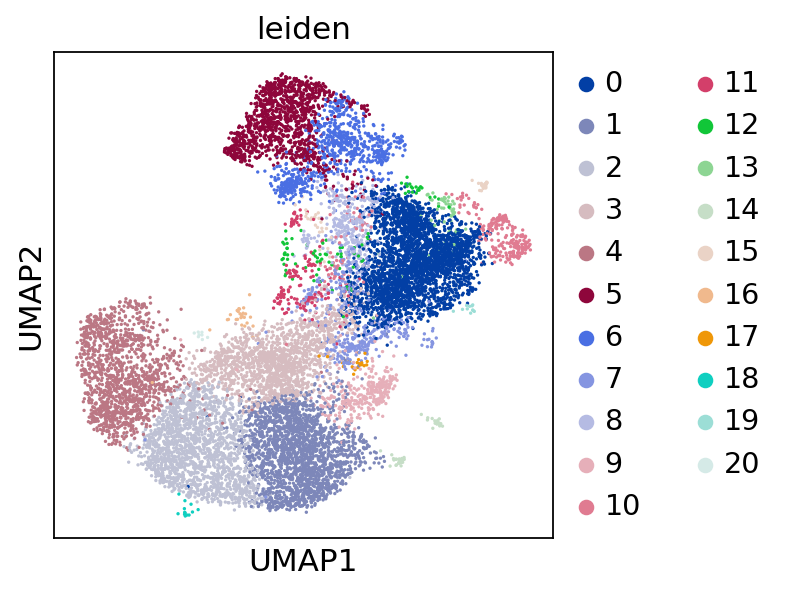

In [119]:
sc.pp.neighbors(adata, use_rep="X_pca", metric="cosine",n_neighbors=100, random_state = 112)
sc.tl.leiden(adata)
sc.tl.paga(adata)
sc.pl.paga(adata, plot=False)  # remove `plot=False` if you want to see the coarse-grained graph
sc.tl.umap(adata,init_pos='paga')
#sc.pl.umap(adata,color='leiden')

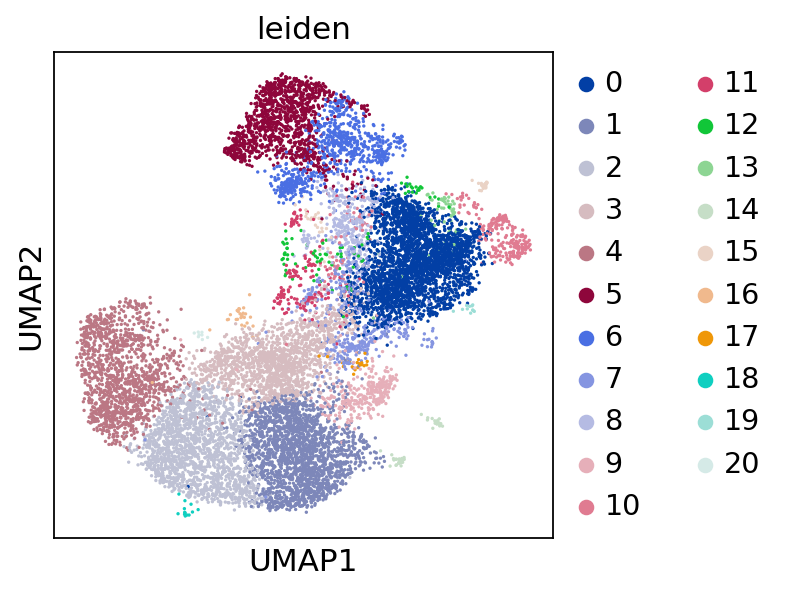

In [121]:
sc.pl.umap(adata,color=['leiden'])

In [161]:
adata.obs['leiden'].value_counts()[adata.obs['leiden'].value_counts()<100].index

CategoricalIndex(['12', '13', '14', '15', '16', '17', '18', '19', '20'], categories=['0', '1', '2', '3', '4', '5', '6', '7', ...], ordered=False, dtype='category')

In [162]:
adata=adata[~adata.obs['leiden'].isin(adata.obs['leiden'].value_counts()[adata.obs['leiden'].value_counts()<100].index)]
adata

View of AnnData object with n_obs × n_vars = 12839 × 2000
    obs: 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'SRR', 'Cancer', 'Tissue', 'Developmental_Stage', 'sample', 'Type', 'n_genes', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'domain', 'leiden', 'SRR1', 'balancing_weight', 'n_counts', 'major_celltype', 'major_celltype_new', 'velocity_self_transition', 'root_cells', 'end_points', 'velocity_pseudotime', 'latent_time', 'pt', 'major_celltype1'
    var: 'gene_ids', 'feature_types', 'genome', 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std', 'chrom', 'chromStart', 'chromEnd', 'name', 'score', 'strand', 'thickStart', 'thickEnd', 'itemRgb', 'blockCount', 'blockSizes', 'blockStarts', 'gene_id', 'gene_type', 

In [175]:
scv.tl.recover_dynamics(adata,n_jobs=10)

recovering dynamics (using 10/12 cores)
    finished (0:00:21) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)


In [176]:
scv.tl.velocity(adata, mode='dynamical',show_progress_bar=False)
scv.tl.velocity_graph(adata,n_jobs=10)

computing velocities
    finished (0:00:01) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 10/12 cores)
    finished (0:00:04) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


computing velocity embedding
    finished (0:00:02) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


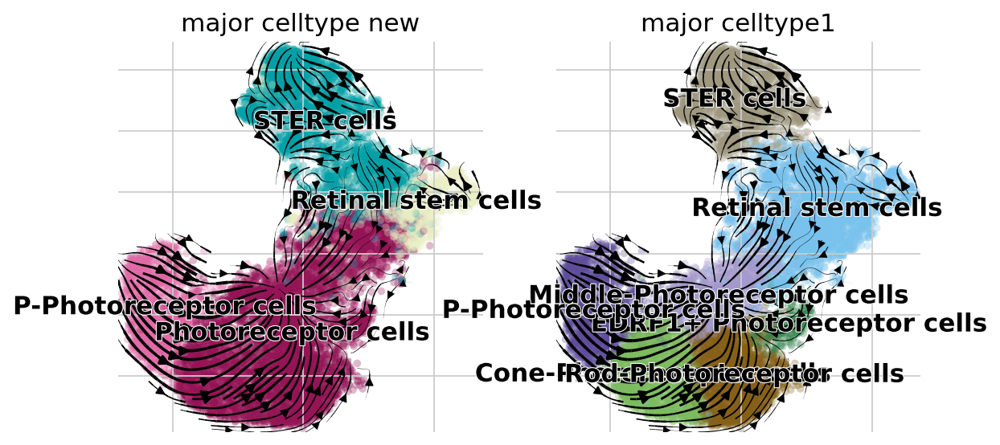

In [177]:
scv.pl.velocity_embedding_stream(adata, basis='umap',color=['major_celltype_new'])

In [16]:
scv.tl.latent_time(adata)
adata

computing terminal states
    identified 4 regions of root cells and 2 regions of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
computing latent time using root_cells as prior
    finished (0:00:01) --> added 
    'latent_time', shared time (adata.obs)


AnnData object with n_obs × n_vars = 13161 × 2000
    obs: 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'SRR', 'Cancer', 'Tissue', 'Developmental_Stage', 'sample', 'Type', 'n_genes', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'domain', 'leiden', 'SRR1', 'balancing_weight', 'n_counts', 'major_celltype', 'major_celltype_new', 'velocity_self_transition', 'root_cells', 'end_points', 'velocity_pseudotime', 'latent_time'
    var: 'gene_ids', 'feature_types', 'genome', 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std', 'chrom', 'chromStart', 'chromEnd', 'name', 'score', 'strand', 'thickStart', 'thickEnd', 'itemRgb', 'blockCount', 'blockSizes', 'blockStarts', 'gene_id', 'gene_type', 'hgnc_id', 'havana_gene', 'tag', 

In [197]:
adata.write_h5ad('data/photo.h5ad',compression='gzip')

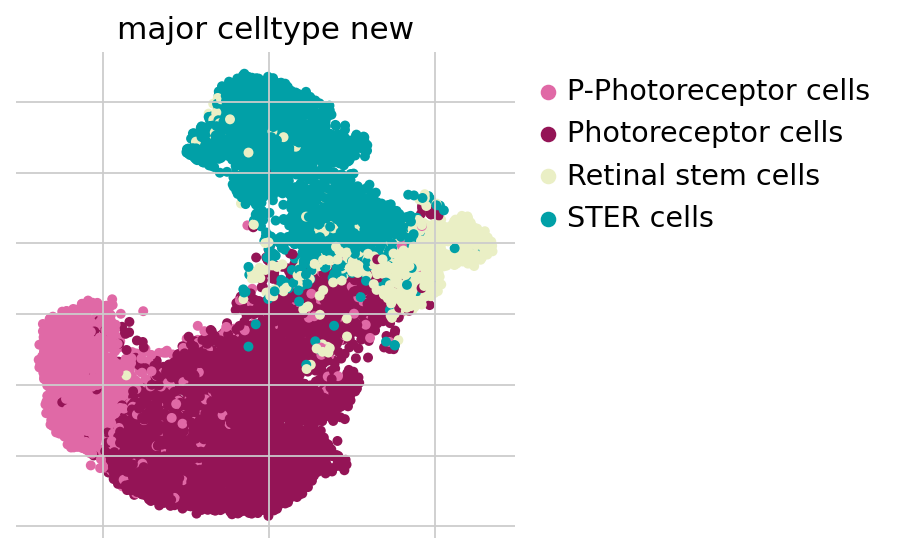

In [446]:
scv.pl.scatter(adata, color='major_celltype_new', color_map='Reds',show=False, size=80)
plt.savefig('result_3/all_celltype.png',dpi=300,bbox_inches='tight')

In [ ]:
scv.pl.scatter(adata, color='latent_time', color_map='Reds', size=80)

In [111]:
retina_dict_chatgpt = {
    'Photoreceptor cells': ['RHO', 'CRX', 'RCVRN', 'SAG'],
    'Bipolar cells': ['PRKCA', 'NRGN', 'TH', 'CCK'],
    'Horizontal cells': ['CALB1', 'GABRA1', 'PRKCA'],
    'Amacrine cells': ['SLC6A1', 'CALB2', 'SLC6A9', 'SST'],
    'Retinal ganglion cells': ['POU4F1', 'THY1', 'NEFL', 'TUBB3', 'ISL1', 'ATOH7'],
    'Müller glia cells': ['GLUL', 'VIM', 'RLBP1', 'CSPG4'],
    'Rod photoreceptor cells': ['RHO', 'CNGB1', 'GNAT1', 'SAG'],
    'Cone photoreceptor cells': ['CRX', 'OPN1LW', 'OPN1MW', 'OPN1SW', 'GNAT2'],
    'Retinal pigment epithelium (RPE) cells': ['BEST1', 'RLBP1', 'RPE65', 'TYR'],
    'Microglia cells': ['IBA1', 'CD68',  'TREM2'],
    'Astrocytes': ['GFAP', 'S100B', 'AQP4', 'GJA1'],
    'Retinal progenitor cells (RPCs)': ['PAX6', 'NESTIN', 'SOX2', 'VSX2'],
    'Pericytes': ['PDGFRB', 'ACTA2', 'CD13', 'RGS5'],
    'Myeloid cells': ['CD45',  'CD68', 'CD163']
}
all_genes=adata.raw.var.index.tolist()
for key in retina_dict_chatgpt.keys():
    for gene in retina_dict_chatgpt[key]:
        if gene not in all_genes:
            retina_dict_chatgpt[key].remove(gene)
retina_dict_chatgpt         

{'Photoreceptor cells': ['RHO', 'CRX', 'RCVRN', 'SAG'],
 'Bipolar cells': ['PRKCA', 'NRGN', 'TH', 'CCK'],
 'Horizontal cells': ['CALB1', 'GABRA1', 'PRKCA'],
 'Amacrine cells': ['SLC6A1', 'CALB2', 'SLC6A9', 'SST'],
 'Retinal ganglion cells': ['POU4F1',
  'THY1',
  'NEFL',
  'TUBB3',
  'ISL1',
  'ATOH7'],
 'Müller glia cells': ['GLUL', 'VIM', 'RLBP1', 'CSPG4'],
 'Rod photoreceptor cells': ['RHO', 'CNGB1', 'GNAT1', 'SAG'],
 'Cone photoreceptor cells': ['CRX', 'OPN1LW', 'OPN1MW', 'OPN1SW', 'GNAT2'],
 'Retinal pigment epithelium (RPE) cells': ['BEST1', 'RLBP1', 'RPE65', 'TYR'],
 'Microglia cells': ['CD68', 'TREM2'],
 'Astrocytes': ['GFAP', 'S100B', 'AQP4', 'GJA1'],
 'Retinal progenitor cells (RPCs)': ['PAX6', 'SOX2', 'VSX2'],
 'Pericytes': ['ACTA2', 'RGS5'],
 'Myeloid cells': ['CD68', 'CD163']}

    using 'X_pca' with n_pcs = 100
Storing dendrogram info using `.uns['dendrogram_leiden']`
categories: 0, 1, 2, etc.
var_group_labels: Photoreceptor cells, Bipolar cells, Horizontal cells, etc.


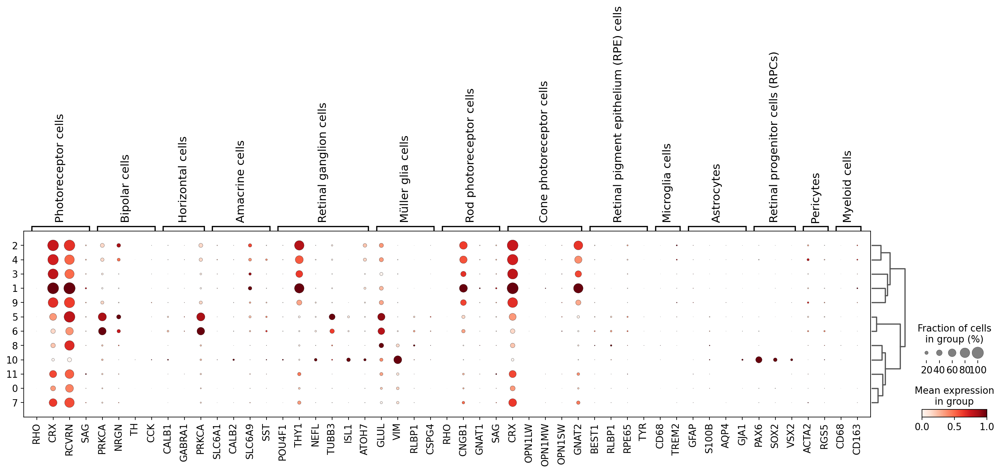

In [163]:
sc.tl.dendrogram(adata,'leiden')
sc.pl.dotplot(adata, retina_dict_chatgpt, 'leiden', dendrogram=True,standard_scale='var')

    using 'X_pca' with n_pcs = 100
Storing dendrogram info using `.uns['dendrogram_major_celltype_new']`
categories: P-Photoreceptor cells, Photoreceptor cells, Retinal stem cells, etc.
var_group_labels: Retinal stem cells, Photoreceptor cells, P-Photoreceptor cells, etc.


{'mainplot_ax': <AxesSubplot:>,
 'group_extra_ax': <AxesSubplot:>,
 'gene_group_ax': <AxesSubplot:>,
 'size_legend_ax': <AxesSubplot:title={'center':'Fraction of cells\nin group (%)'}>,
 'color_legend_ax': <AxesSubplot:title={'center':'Mean expression\nin group'}>}

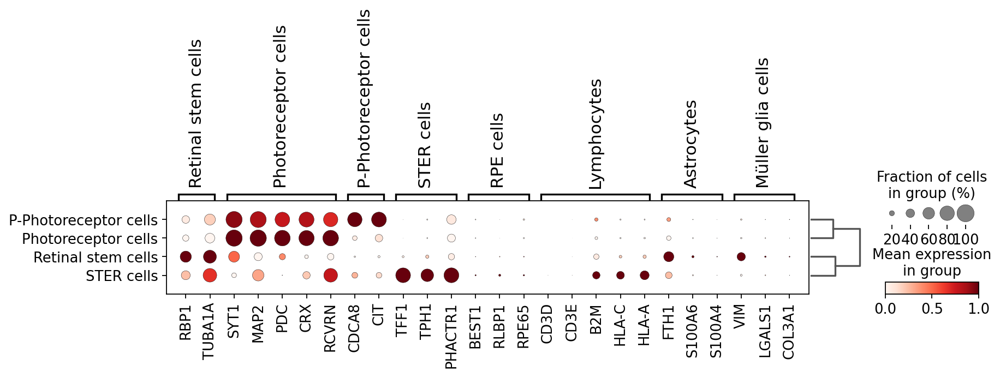

In [165]:
retina_dict={
    'Retinal stem cells':['RBP1','TUBA1A'],
    'Photoreceptor cells':['SYT1','MAP2','PDC','CRX', 'RCVRN',],
    'P-Photoreceptor cells':['CDCA8','CIT',],
    'STER cells':['TFF1','TPH1','PHACTR1'],
    'RPE cells':['BEST1', 'RLBP1', 'RPE65',],
    'Lymphocytes':['CD3D','CD3E','B2M','HLA-C','HLA-A'],
    'Astrocytes':['FTH1','S100A6','S100A4'],
    'Müller glia cells':['VIM','LGALS1','COL3A1'],
}
sc.tl.dendrogram(adata,'major_celltype_new')
sc.pl.dotplot(adata, retina_dict, 'major_celltype_new', dendrogram=True,standard_scale='var',show=False)
#plt.savefig(current_path+'result_1/retina_celltype.png',dpi=300,bbox_inches='tight')

In [166]:
sc.tl.dendrogram(adata,'leiden')
adata.uns['log1p']['base']=None
sc.tl.rank_genes_groups(adata, 'leiden', 
                        use_raw=False,
                        method='t-test',n_genes=100)


    using 'X_pca' with n_pcs = 100
Storing dendrogram info using `.uns['dendrogram_leiden']`
ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


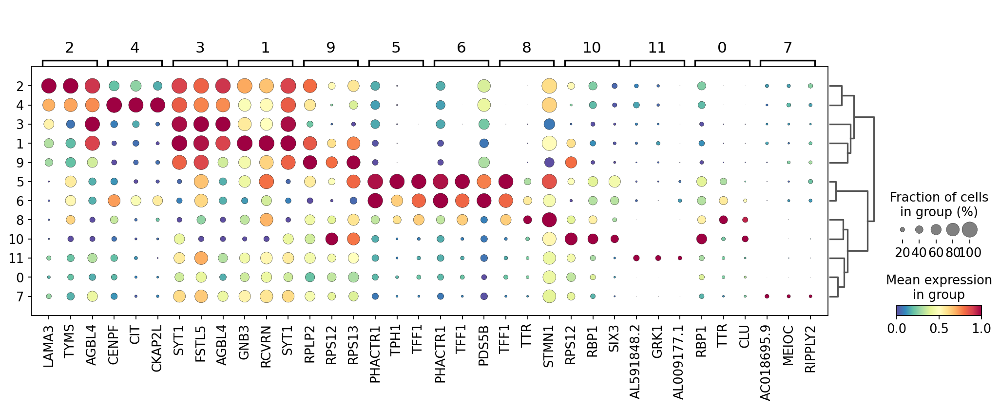

In [167]:
sc.pl.rank_genes_groups_dotplot(adata,groupby='leiden',
                                cmap='Spectral_r',
                                standard_scale='var',n_genes=3)

**finished identifying marker genes by COSG**


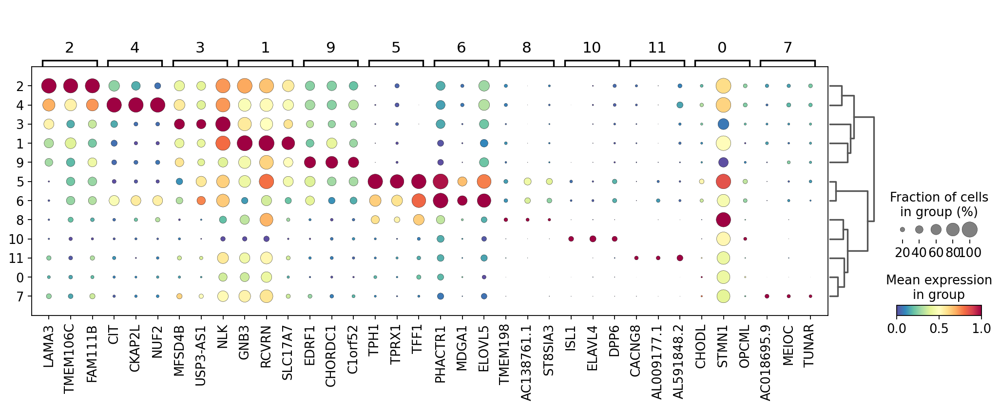

In [168]:
Pyomic.single.cosg(adata, key_added='cosg', groupby='leiden',n_genes_user=10)
sc.pl.rank_genes_groups_dotplot(adata,groupby='leiden',
                                cmap='Spectral_r',key='cosg',
                                standard_scale='var',n_genes=3)

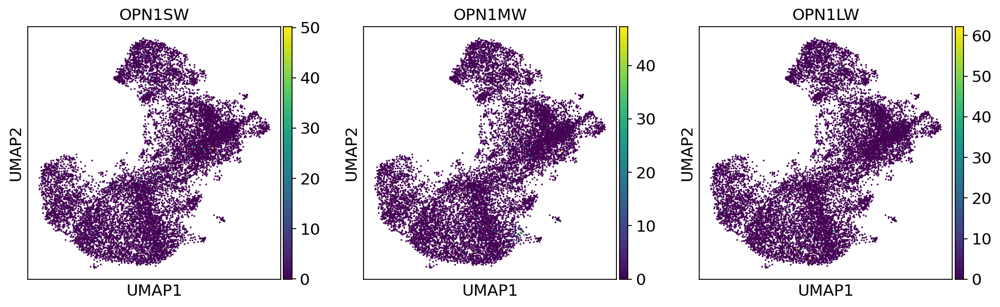

In [145]:
sc.pl.umap(adata,color=['OPN1SW', 'OPN1MW' ,'OPN1LW' ])

In [15]:
# create a dictionary to map cluster to annotation label
#"Transcription-Chaperone Ribosomal Photoreceptor" or "TCR Photoreceptor" 
cluster2annotation = {
     '0': 'Retinal stem cells',
     '1': 'Rod-Photoreceptor cells',
     '2': 'Cone-Photoreceptor cells',#Germ-cell(Oid)
     '3': 'Middle-Photoreceptor cells',#Germ-cell(Oid)
     '4': 'P-Photoreceptor cells',
     '5': 'STER cells',
     '6': 'STER cells',
     '7': 'Retinal stem cells',
     '8': 'Retinal stem cells',
     '9': 'TCR Photoreceptor cells',
     '10': 'Retinal stem cells',#Germ-cell(Oid)
     '11': 'Retinal stem cells',


}
adata.obs['major_celltype1'] = adata.obs['leiden'].map(cluster2annotation).astype('category')

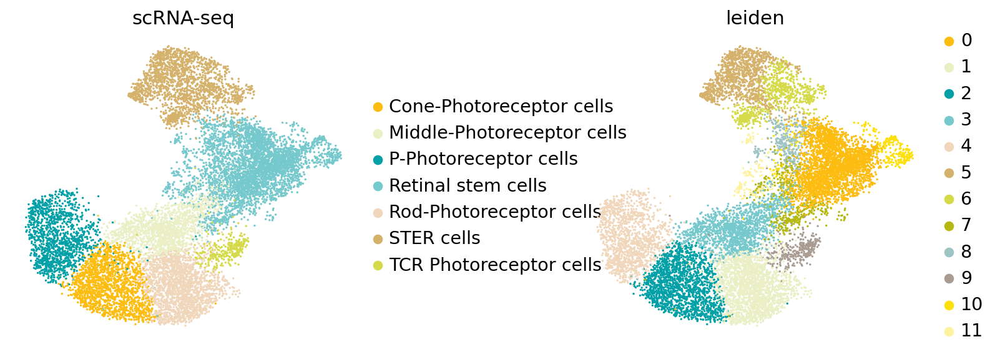

In [17]:
ax=sc.pl.embedding(
    adata,
    basis="X_umap",
    color=['major_celltype1','leiden'],
    title='scRNA-seq',
    frameon=False,
    ncols=3,
    #save='_figure1_celltype.png',
    return_fig=True,
    wspace=0.5,
    show=False,
    palette=sc_color[16:],
)

In [2]:
adata=sc.read('data/photo.h5ad')
adata

AnnData object with n_obs × n_vars = 12839 × 2000
    obs: 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'SRR', 'Cancer', 'Tissue', 'Developmental_Stage', 'sample', 'Type', 'n_genes', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'domain', 'leiden', 'SRR1', 'balancing_weight', 'n_counts', 'major_celltype', 'major_celltype_new', 'velocity_self_transition', 'root_cells', 'end_points', 'velocity_pseudotime', 'latent_time', 'pt', 'major_celltype1'
    var: 'gene_ids', 'feature_types', 'genome', 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std', 'chrom', 'chromStart', 'chromEnd', 'name', 'score', 'strand', 'thickStart', 'thickEnd', 'itemRgb', 'blockCount', 'blockSizes', 'blockStarts', 'gene_id', 'gene_type', 'hgnc_id

2023-03-08 17:09:14.015767	Running VIA over input data of 12839 (samples) x 100 (features)
2023-03-08 17:09:14.015817	Knngraph has 20 neighbors
2023-03-08 17:09:16.202614	Finished global pruning of 20-knn graph used for clustering at level of 0.15. Kept 42.8 % of edges. 
2023-03-08 17:09:16.244482	Number of connected components used for clustergraph  is 1
2023-03-08 17:09:17.986249	Commencing community detection
2023-03-08 17:09:18.173123	Finished running Leiden algorithm. Found 217 clusters.
2023-03-08 17:09:18.175940	Merging 190 very small clusters (<10)
2023-03-08 17:09:18.178750	Finished detecting communities. Found 27 communities
2023-03-08 17:09:18.179487	Making cluster graph. Global cluster graph pruning level: 0.5
2023-03-08 17:09:18.200581	Graph has 1 connected components before pruning
2023-03-08 17:09:18.202477	Graph has 1 connected components after pruning
2023-03-08 17:09:18.202636	Graph has 1 connected components after reconnecting
2023-03-08 17:09:18.203199	0.0% links tr

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


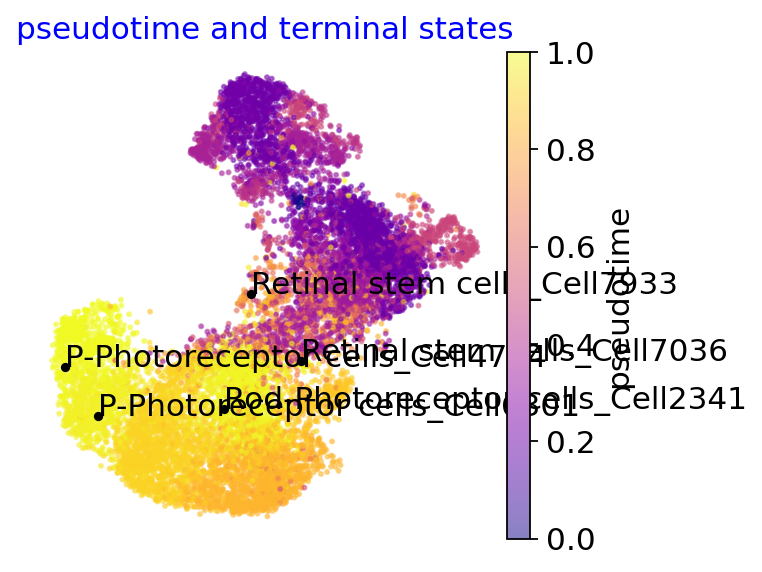

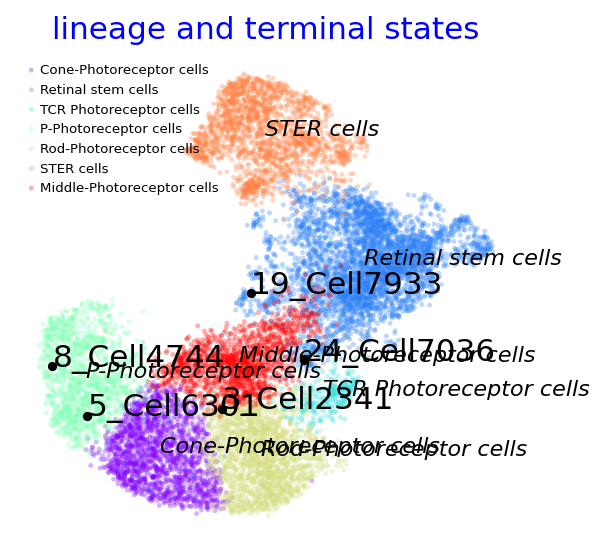

2023-03-08 17:09:25.135251	Time elapsed 9.9 seconds


In [18]:
jac_std_global = 0.15 #(smaller values increase granularity of clusters)
n_pcs = 100
knn = 20
cluster_graph_pruning_std = 0.5 #(smaller values remove more edges in the cluster graph)
v0_toobig = .3 #(clusters that form more than 30% of entire population will be re-clustered)
root = None # No user-defined guidance for finding initial state [63] is a suitable root cell index
dataset = ''
random_seed = 112
velo_weight=0.5 #weight given to velocity matrix from scvelo. 1-velo_weight is assigned to gene-gene kernel
embedding = adata.obsm['X_umap'][:, 0:2]
true_label = adata.obs['major_celltype1'].tolist()
velocity_matrix=adata.layers['velocity']
gene_matrix=adata.X
pca_loadings = adata.varm['PCs'] # this is optional and offers slight adjustment of the locations of cells based on velocity

#impute genes we want to use in gene-trends later
#gene_list_magic_short = ['Sst','Ins1','Ins2','Gcg','Ghrl']
#df_ = pd.DataFrame(adata.X.todense())
#df_.columns = [i for i in adata.var_names]
#df_ = df_[gene_list_magic_short]


v0 = via.VIA(adata.obsm['X_pca'][:, 0:n_pcs], true_label, jac_std_global=jac_std_global, dist_std_local=1, knn=knn,
             too_big_factor=v0_toobig, root_user=root, dataset=dataset, random_seed=random_seed,
           is_coarse=True, preserve_disconnected=True, pseudotime_threshold_TS=50,
             cluster_graph_pruning_std=cluster_graph_pruning_std,
             piegraph_arrow_head_width=0.15,embedding = embedding,
             piegraph_edgeweight_scalingfactor=2.5, velocity_matrix=velocity_matrix,
                    gene_matrix=gene_matrix, velo_weight=velo_weight,  edgebundle_pruning_twice=False, edgebundle_pruning=0.15, pca_loadings = adata.varm['PCs']) # pca_loadings is optional #edge_bundling_twice = True would remove more of the edges
v0.run_VIA()

Text(0.5, 1.0, 'Pseudotime')

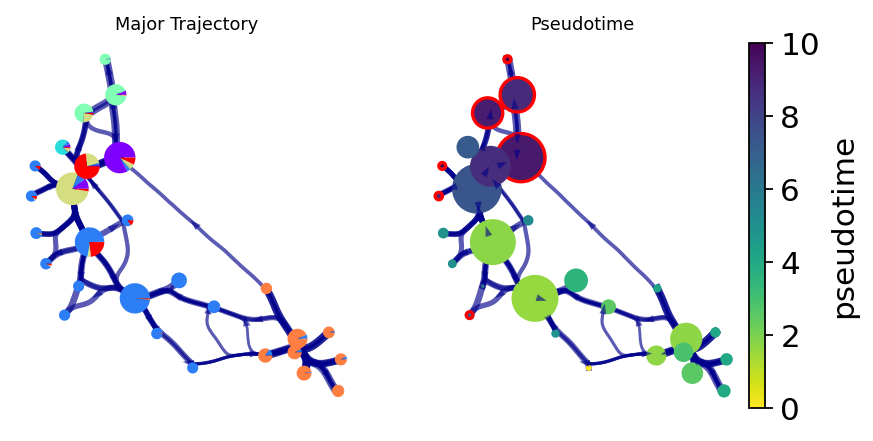

In [5]:
fig, ax, ax1 = via.draw_piechart_graph(via_object=v0,dpi=80,
                                       show_legend=False,ax_text=False,fontsize=4)
fig.set_size_inches(6,3)
ax.set_title('Major Trajectory',fontsize=8)
#ax.legend(bbox_to_anchor=(0.5, 0), loc='upper center', borderaxespad=0.,fontsize=8)
ax1.set_title('Pseudotime',fontsize=8)

In [208]:
help(via.draw_trajectory_gams)

Help on function draw_trajectory_gams in module pyVIA.plotting_via:

draw_trajectory_gams(via_object, via_fine=None, embedding: numpy.ndarray = None, idx: Union[list, NoneType] = None, title_str: str = 'Pseudotime', draw_all_curves: bool = True, arrow_width_scale_factor: float = 15.0, scatter_size: float = 50, scatter_alpha: float = 0.5, linewidth: float = 1.5, marker_edgewidth: float = 1, cmap_pseudotime: str = 'viridis_r', dpi: int = 150, highlight_terminal_states: bool = True, use_maxout_edgelist: bool = False)
    projects the graph based coarse trajectory onto a umap/tsne embedding
    
    :param via_object: via object
    :param via_fine: via object suggest to use via_object only unless you found that running via_fine gave better pathways
    :param embedding: 2d array [n_samples x 2] with x and y coordinates of all n_samples. Umap, tsne, pca OR use the via computed embedding via_object.embedding
    :param idx: default: None. Or List. if you had previously computed a umap/tsne 

100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00


2023-03-08 01:47:32.641554	Super cluster 1 is a super terminal with sub_terminal cluster 1
2023-03-08 01:47:32.641836	Super cluster 5 is a super terminal with sub_terminal cluster 5
2023-03-08 01:47:32.642020	Super cluster 7 is a super terminal with sub_terminal cluster 7
2023-03-08 01:47:32.642224	Super cluster 22 is a super terminal with sub_terminal cluster 22
2023-03-08 01:47:32.642404	Super cluster 23 is a super terminal with sub_terminal cluster 23
2023-03-08 01:47:32.642583	Super cluster 24 is a super terminal with sub_terminal cluster 24
2023-03-08 01:47:32.642757	Super cluster 25 is a super terminal with sub_terminal cluster 25


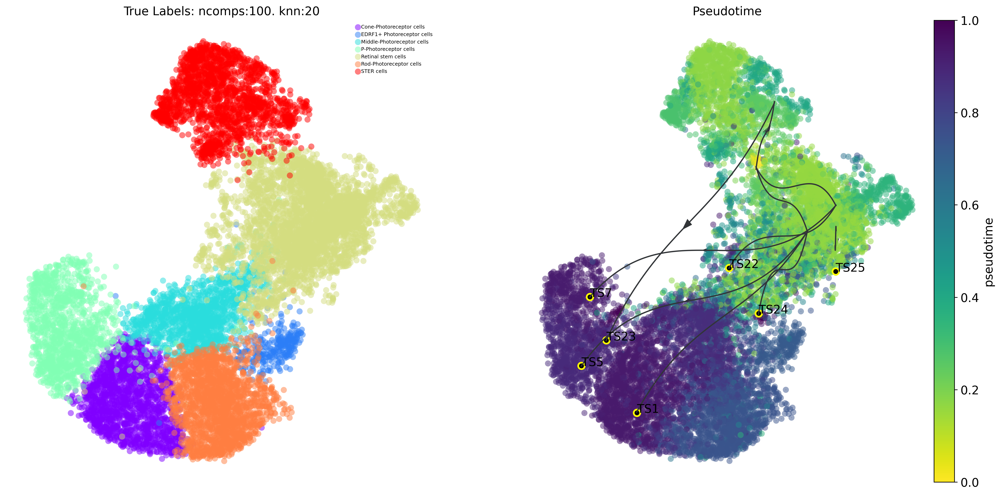

In [180]:
tsnem = adata.obsm['X_umap']
fig, ax, ax1 = via.draw_trajectory_gams(via_object=v0,embedding=tsnem, draw_all_curves=False)

2023-03-08 01:48:09.234478	Marker_lineages: [1, 5, 7, 22, 23, 24, 25]
2023-03-08 01:48:09.239827	The number of components in the original full graph is 1
2023-03-08 01:48:09.239874	For downstream visualization purposes we are also constructing a low knn-graph 
2023-03-08 01:48:10.106604	Check sc pb [0.15  0.154 0.146 0.14  0.139 0.151 0.121]
2023-03-08 01:48:10.274825	Cluster path on clustergraph starting from Root Cluster 26 to Terminal Cluster 1: [26, 2, 3, 19, 0, 1]
2023-03-08 01:48:10.274895	Cluster path on clustergraph starting from Root Cluster 26 to Terminal Cluster 5: [26, 2, 3, 19, 0, 1, 5]
2023-03-08 01:48:10.274915	Cluster path on clustergraph starting from Root Cluster 26 to Terminal Cluster 7: [26, 2, 3, 19, 0, 1, 5, 7]
2023-03-08 01:48:10.274931	Cluster path on clustergraph starting from Root Cluster 26 to Terminal Cluster 22: [26, 2, 3, 19, 0, 4, 22]
2023-03-08 01:48:10.274947	Cluster path on clustergraph starting from Root Cluster 26 to Terminal Cluster 23: [26, 2, 3, 1

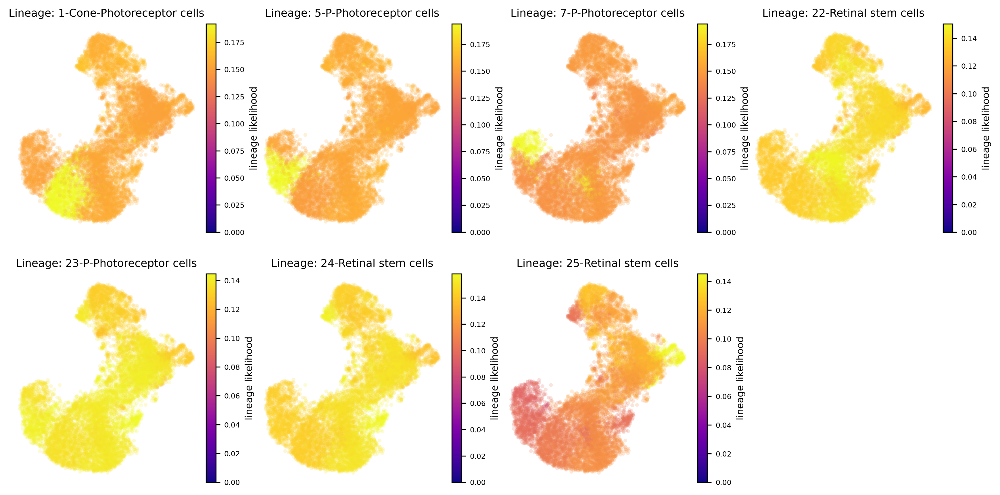

In [181]:
fig, axs= via.draw_sc_lineage_probability(via_object=v0, marker_lineages=v0.terminal_clusters, embedding=tsnem)
fig.set_size_inches(14,7)

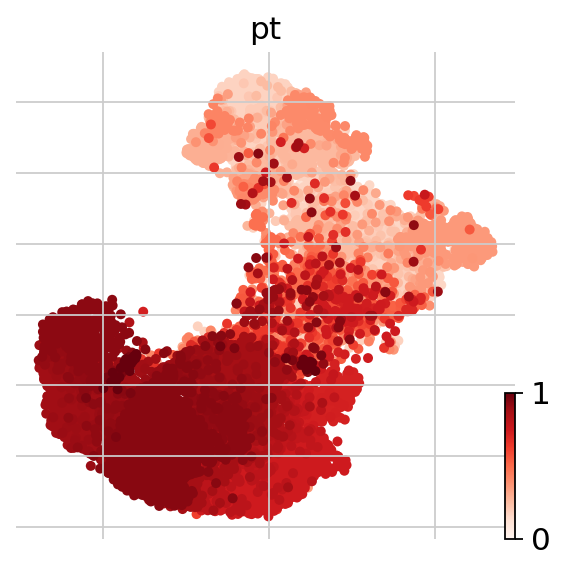

In [182]:
adata.obs['pt']=v0.single_cell_pt_markov
scv.pl.scatter(adata, color='pt', color_map='Reds', size=80)

[<AxesSubplot:title={'center':'major celltype1'}>,
 <AxesSubplot:title={'center':'pt'}>]

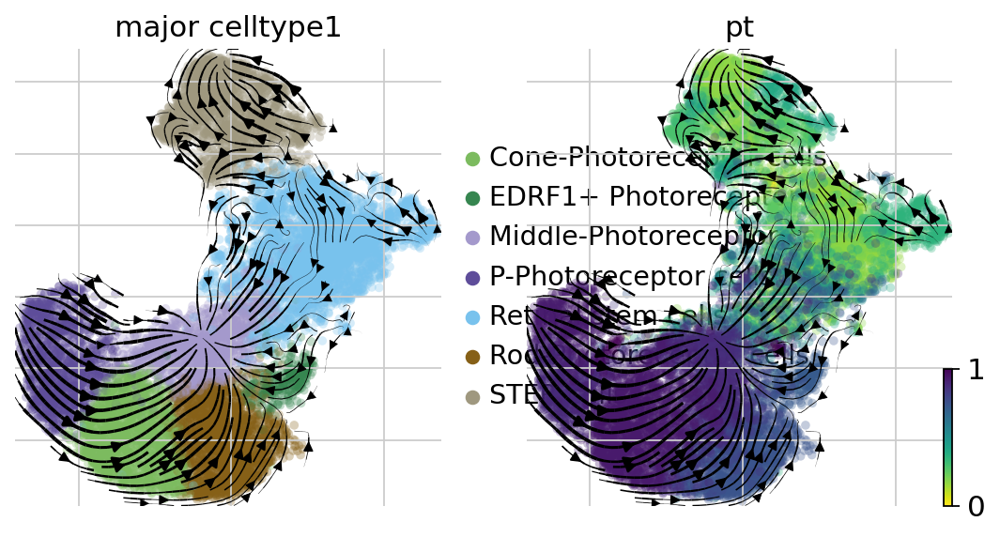

In [188]:
scv.pl.velocity_embedding_stream(adata, basis='umap',color=['major_celltype1','pt',],
                                 legend_loc='right margin',
                                legend_align_text='y',show=False,)

100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (11 of 11) |########################| Elapsed Time: 0:00:00 Time:  0:00:00


2023-03-08 01:57:05.214536	Super cluster 1 is a super terminal with sub_terminal cluster 1
2023-03-08 01:57:05.214829	Super cluster 5 is a super terminal with sub_terminal cluster 5
2023-03-08 01:57:05.215018	Super cluster 7 is a super terminal with sub_terminal cluster 7
2023-03-08 01:57:05.215218	Super cluster 22 is a super terminal with sub_terminal cluster 22
2023-03-08 01:57:05.215395	Super cluster 23 is a super terminal with sub_terminal cluster 23
2023-03-08 01:57:05.215571	Super cluster 24 is a super terminal with sub_terminal cluster 24
2023-03-08 01:57:05.215744	Super cluster 25 is a super terminal with sub_terminal cluster 25


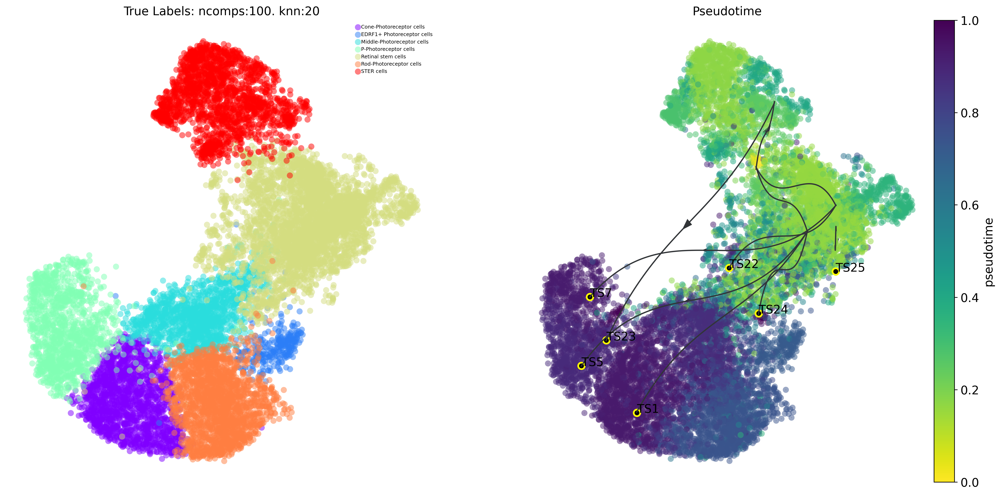

In [196]:
fig, ax, ax1 = via.draw_trajectory_gams(via_object=v0,embedding=embedding, draw_all_curves=False)


In [203]:
from cellrank.tl.kernels import PseudotimeKernel
ptk=PseudotimeKernel(adata,time_key='pt')

In [204]:
ptk.compute_transition_matrix()
ptk.compute_projection(basis='umap')

Computing transition matrix based on `pt`


100%|██████████| 12839/12839 [00:02<00:00, 5893.87cell/s]


    Finish (0:00:04)
Projecting transition matrix onto `umap`
Adding `adata.obsm['T_fwd_umap']`
    Finish (0:00:03)


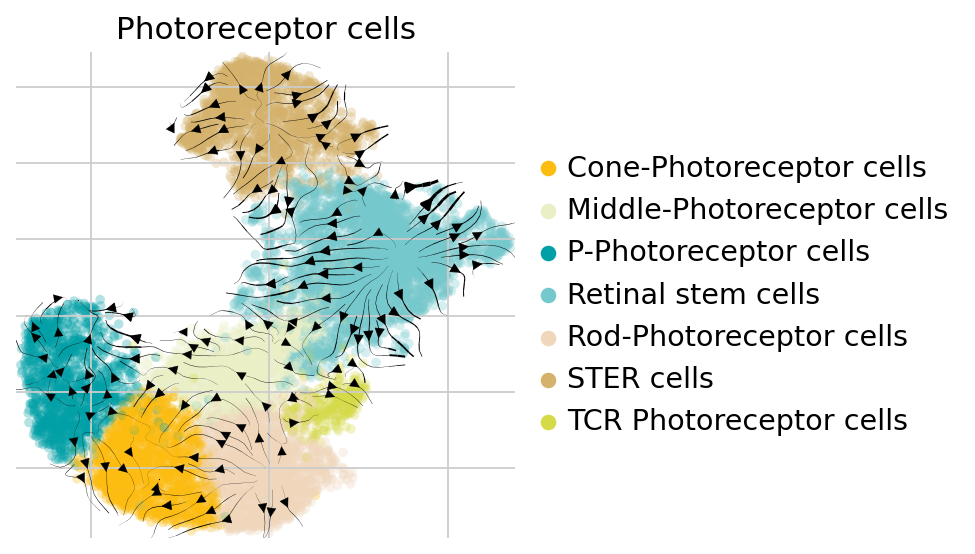

In [399]:
scv.pl.velocity_embedding_stream(adata, vkey='T_fwd',color=['major_celltype1',],
                                 title='Photoreceptor cells',
                                 legend_loc='right margin',
                                legend_align_text='y',show=False,)
plt.savefig('result_3/P_celltype.png',dpi=300,bbox_inches='tight')

<AxesSubplot:title={'center':'Photoreceptor cells'}>

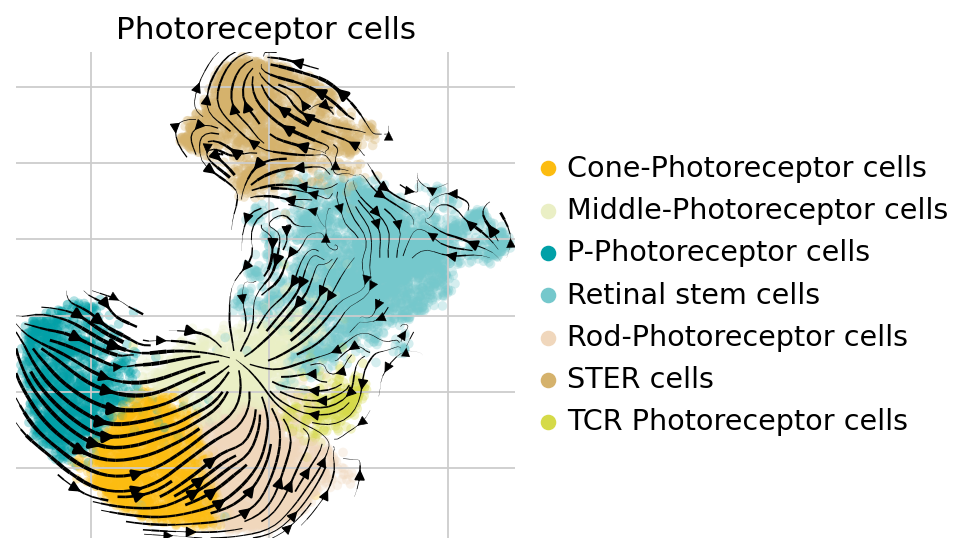

In [16]:
scv.pl.velocity_embedding_stream(adata, color=['major_celltype1',],
                                 title='Photoreceptor cells',
                                 legend_loc='right margin',
                                legend_align_text='y',show=False,)

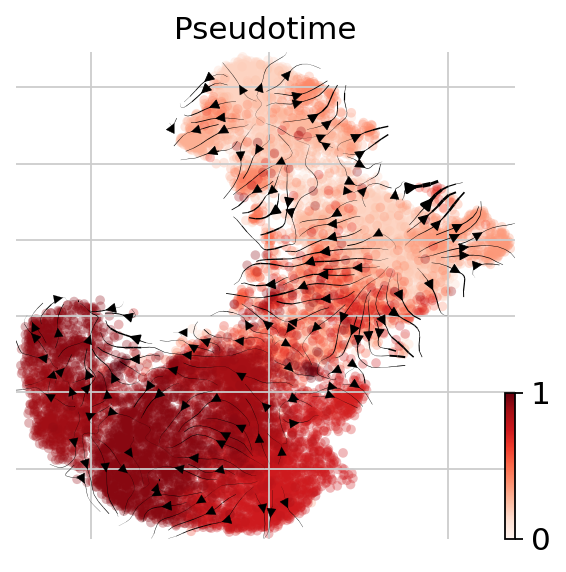

In [400]:
scv.pl.velocity_embedding_stream(adata, vkey='T_fwd',color=['pt',],
                                 title='Pseudotime',
                                 legend_loc='right margin',cmap='Reds',
                                legend_align_text='y',show=False,)
plt.savefig('result_3/P_pt.png',dpi=300,bbox_inches='tight')

In [211]:
adata.obs['major_celltype1'].unique()

['Retinal stem cells', 'Middle-Photoreceptor cells', 'P-Photoreceptor cells', 'EDRF1+ Photoreceptor cells', 'Rod-Photoreceptor cells', 'Cone-Photoreceptor cells', 'STER cells']
Categories (7, object): ['Cone-Photoreceptor cells', 'EDRF1+ Photoreceptor cells', 'Middle-Photoreceptor cells', 'P-Photoreceptor cells', 'Retinal stem cells', 'Rod-Photoreceptor cells', 'STER cells']

In [213]:
n_truegroups = len(set(adata.obs['major_celltype1'].unique()))
line_true = np.linspace(0, 1, n_truegroups)
color_true_list = [plt.cm.rainbow(color) for color in line_true]

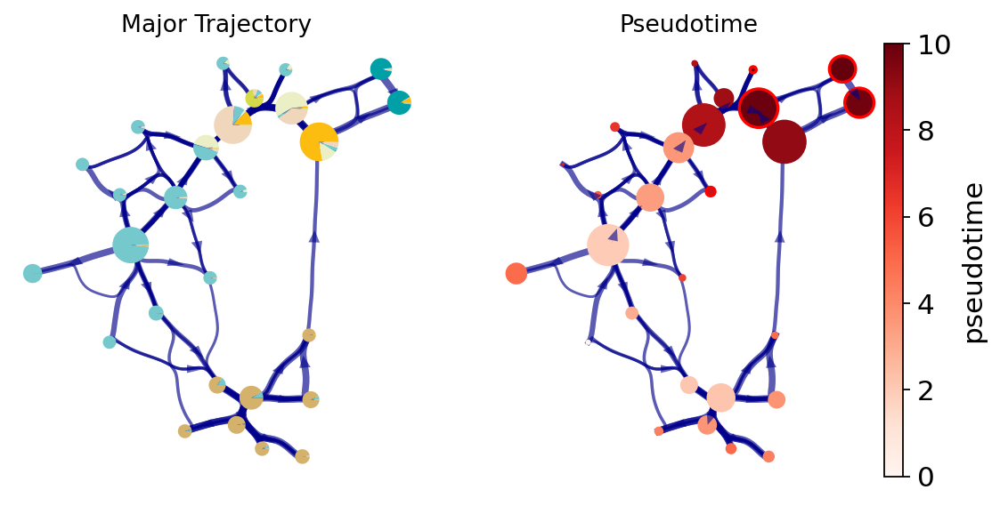

In [19]:
fig, ax, ax1 = draw_piechart_graph(adata=adata,clusters='major_celltype1',
                                   via_object=v0,cmap='Reds',dpi=80,
                                   show_legend=False,ax_text=False,fontsize=4)
fig.set_size_inches(8,4)
ax.set_title('Major Trajectory',fontsize=12)
#ax.legend(bbox_to_anchor=(0.5, 0), loc='upper center', borderaxespad=0.,fontsize=8)
ax1.set_title('Pseudotime',fontsize=12)

plt.savefig('result_3/P_tr.png',dpi=300,bbox_inches='tight')

In [381]:
ax1


<AxesSubplot:title={'center':'Pseudotime'}>

<AxesSubplot:title={'center':'scATAC-seq'}, xlabel='X_umap1', ylabel='X_umap2'>

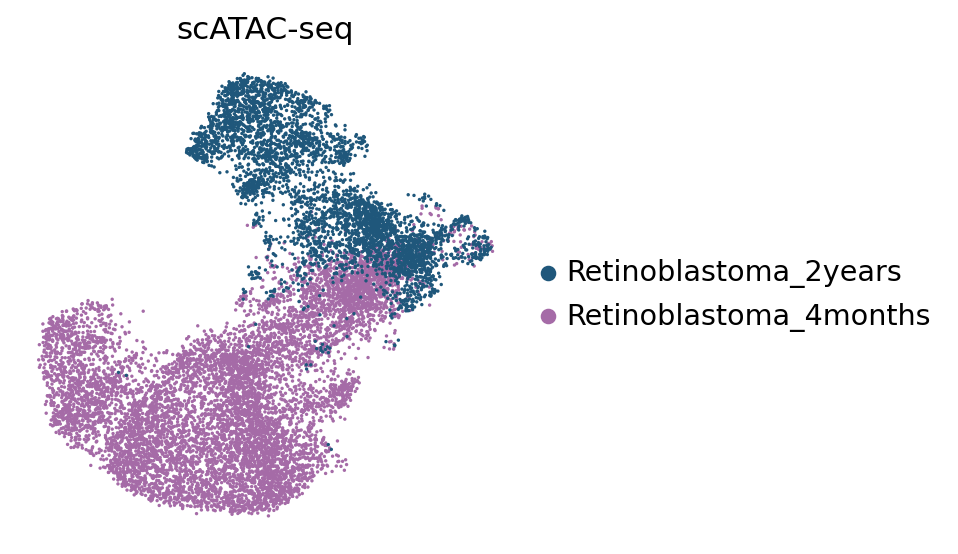

In [274]:
sc.pl.embedding(
    adata,
    basis="X_umap",
    color=['Developmental_Stage'],
    title='scATAC-seq',
    frameon=False,
    ncols=1,
    #save='_figure1_celltype.png',
    #return_fig=True,
    #wspace=0.5,
    show=False,
    
    palette=sc_color[11:],
)

In [338]:
adata.var.loc[adata.var['fit_likelihood']>0.2].index

Index(['IGSF21', 'RCAN3', 'AL136987.1', 'CENPF', 'GNG4', 'HELLS', 'TPH1',
       'FAM111B', 'SYT1', 'PDS5B', 'RFC3', 'IPO5', 'CEP152', 'GSG1L', 'SHCBP1',
       'RCVRN', 'TYMS', 'LAMA3', 'ASF1B', 'ADGRE2', 'ZNF43', 'ZNF676', 'TPRX1',
       'PPM1G', 'SLC8A1', 'CYTOR', 'NCAPH', 'CKAP2L', 'MYBL2', 'BHLHE40',
       'TAFA4', 'POLQ', 'PEX5L', 'FSTL5', 'CLPTM1L', 'IQGAP2', 'CPLX2',
       'SNRPC', 'TAF11', 'XPO5', 'ANLN', 'DBF4', 'AKAP9', 'FBXO43'],
      dtype='object')

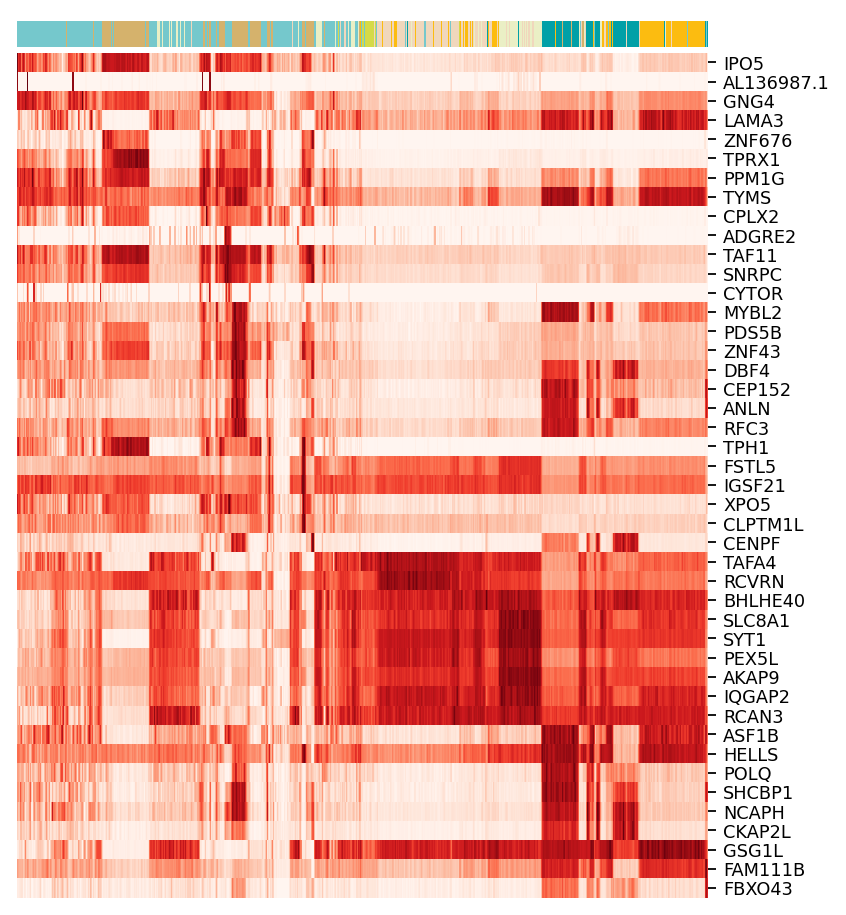

In [402]:
top_genes_neg = adata.var.loc[adata.var['fit_likelihood']>0.2].index
a=scv.pl.heatmap(adata, var_names=top_genes_neg, sortby='pt', col_color=['major_celltype1'],
               n_convolve=30,figsize=(6,6),yticklabels=True,show=False,color_map='Reds')
a.ax_heatmap.yaxis.set_tick_params(labelsize=8)
a.ax_col_colors.yaxis.set_ticks([1.5],['major_celltype1'],ha='left')
a.ax_col_colors.yaxis.tick_right()
labels=a.ax_col_colors.yaxis.get_ticklabels()
plt.setp(labels, fontsize=8)
plt.savefig('result_3/P_time_gene.png',dpi=300,bbox_inches='tight')

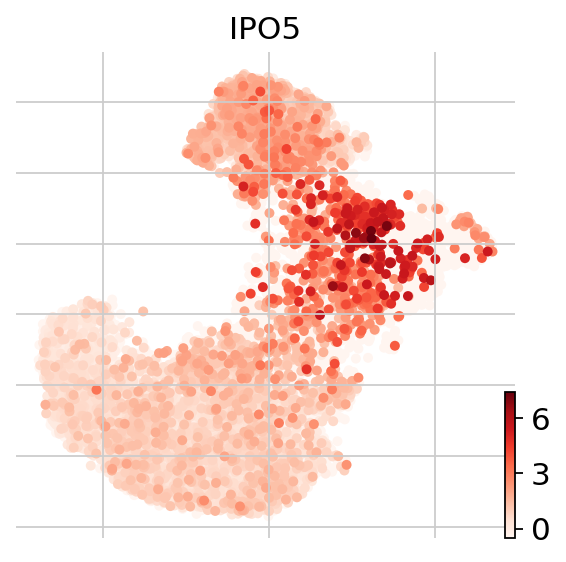

In [281]:
scv.pl.scatter(adata, color='IPO5', color_map='Reds', size=80)

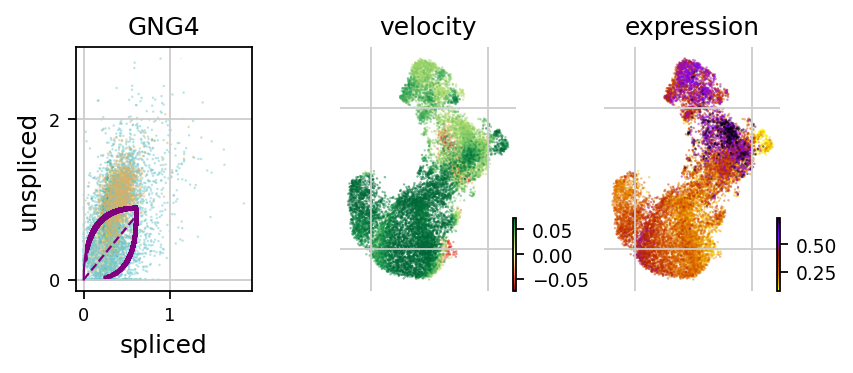

In [347]:
scv.pl.velocity(adata, ['GNG4'],color='major_celltype1', ncols=2)

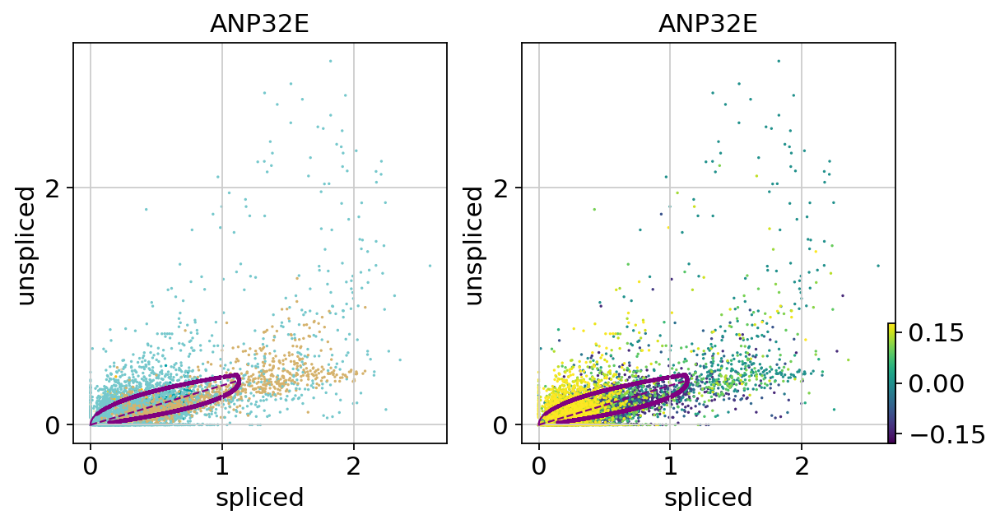

In [350]:
scv.pl.scatter(adata, 'ANP32E', color=['major_celltype1', 'velocity'],
               )

In [391]:
scv.tl.rank_dynamical_genes(adata, groupby='major_celltype1')
df = scv.get_df(adata, 'rank_dynamical_genes/names')
df.head(5)

ranking genes by cluster-specific likelihoods
    finished (0:00:01) --> added 
    'rank_dynamical_genes', sorted scores by group ids (adata.uns)


,Cone-Photoreceptor cells,Middle-Photoreceptor cells,P-Photoreceptor cells,Retinal stem cells,Rod-Photoreceptor cells,STER cells,TCR Photoreceptor cells
0,SLC8A1,SYT1,SYT1,SYT1,SLC8A1,ZNF676,SYT1
1,SYT1,SLC8A1,SLC8A1,SLC8A1,AKAP9,TPH1,SLC8A1
2,PEX5L,GSG1L,GSG1L,AKAP9,PEX5L,AKAP9,PEX5L
3,AKAP9,AKAP9,FSTL5,FSTL5,GSG1L,TAF11,AKAP9
4,FSTL5,FSTL5,PEX5L,PEX5L,SYT1,IPO5,GSG1L


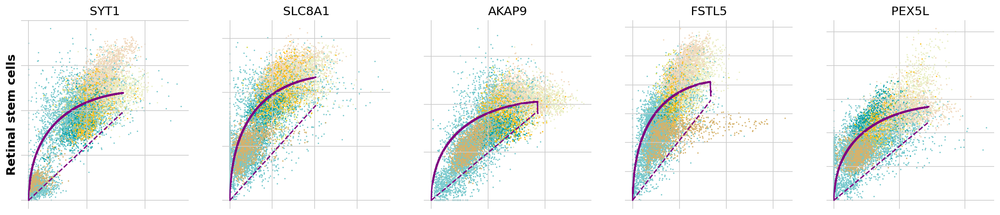

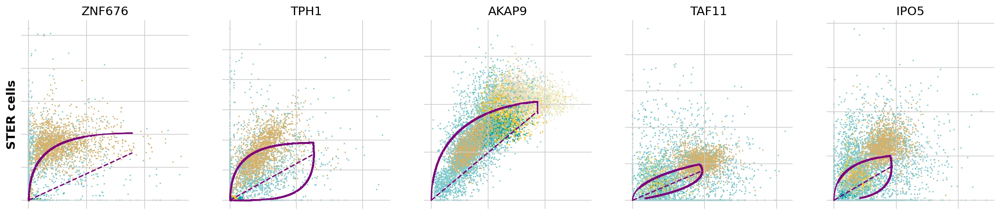

In [392]:
kwargs = dict(frameon=False, size=10, linewidth=1.5,
              )

scv.pl.scatter(adata, df['Retinal stem cells'][:5], color='major_celltype1',ylabel='Retinal stem cells', **kwargs)
scv.pl.scatter(adata, df['STER cells'][:5], color='major_celltype1',ylabel='STER cells', **kwargs)

shape of transition matrix raised to power 3 (12839, 12839)


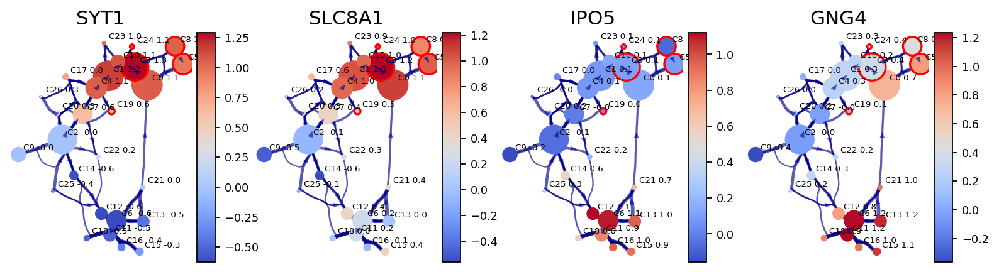

In [23]:
df_ = pd.DataFrame(adata.X)
df_.columns = [i for i in adata.var_names]

gene_list_magic = ['GSG1L','FAM111B','POLQ','SHCBP1']
gene_list_magic = ['SYT1','SLC8A1','IPO5','GNG4']
df_magic = v0.do_impute(df_, magic_steps=3, gene_list=gene_list_magic)
df_magic['parc'] = v0.labels
df_magic_cluster = df_magic.groupby('parc', as_index=True).mean()

fig, axs = via.draw_clustergraph(via_object=v0, type_data='gene', 
                                 gene_exp=df_magic_cluster, gene_list=gene_list_magic, arrow_head=0.1)
fig.set_size_inches(12,3)
fig.savefig('result_3/P_{}.png'.format(str(gene_list_magic)),dpi=300,bbox_inches='tight')

In [20]:
help(via.draw_clustergraph)

Help on function draw_clustergraph in module pyVIA.plotting_via:

draw_clustergraph(via_object, type_data='gene', gene_exp='', gene_list='', arrow_head=0.1, edgeweight_scale=1.5, cmap=None, label_=True)
    :param via_object:
    :param type_data:
    :param gene_exp:
    :param gene_list:
    :param arrow_head:
    :param edgeweight_scale:
    :param cmap:
    :param label_:
    :return: fig, axs



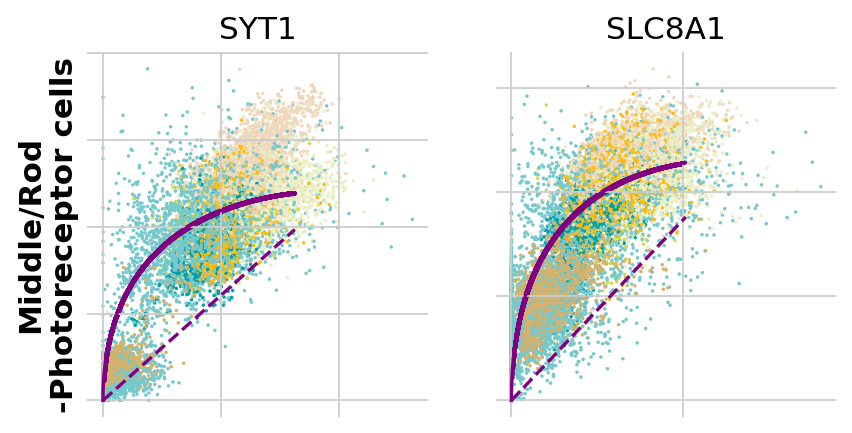

In [561]:
#fig, ax = plt.subplots(figsize=(3,3))
scv.pl.scatter(adata, gene_list_magic, color='major_celltype1',
               ylabel='Middle/Rod\n-Photoreceptor cells', show=False,figsize=(3,3),
               **kwargs)
plt.savefig('result_3/P_v_{}.png'.format(str(gene_list_magic)),dpi=300,bbox_inches='tight')

In [282]:
adata.obs['major_celltype1'].unique()

['Retinal stem cells', 'Middle-Photoreceptor cells', 'P-Photoreceptor cells', 'EDRF1+ Photoreceptor cells', 'Rod-Photoreceptor cells', 'Cone-Photoreceptor cells', 'STER cells']
Categories (7, object): ['Cone-Photoreceptor cells', 'EDRF1+ Photoreceptor cells', 'Middle-Photoreceptor cells', 'P-Photoreceptor cells', 'Retinal stem cells', 'Rod-Photoreceptor cells', 'STER cells']

In [322]:
adata=adata[:,[i for i in adata.var.index if 'RPS' not in i]]

In [324]:
adata=adata[:,[i for i in adata.var.index if 'RPL' not in i]]

    using 'X_pca' with n_pcs = 100
Storing dendrogram info using `.uns['dendrogram_major_celltype1']`
ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


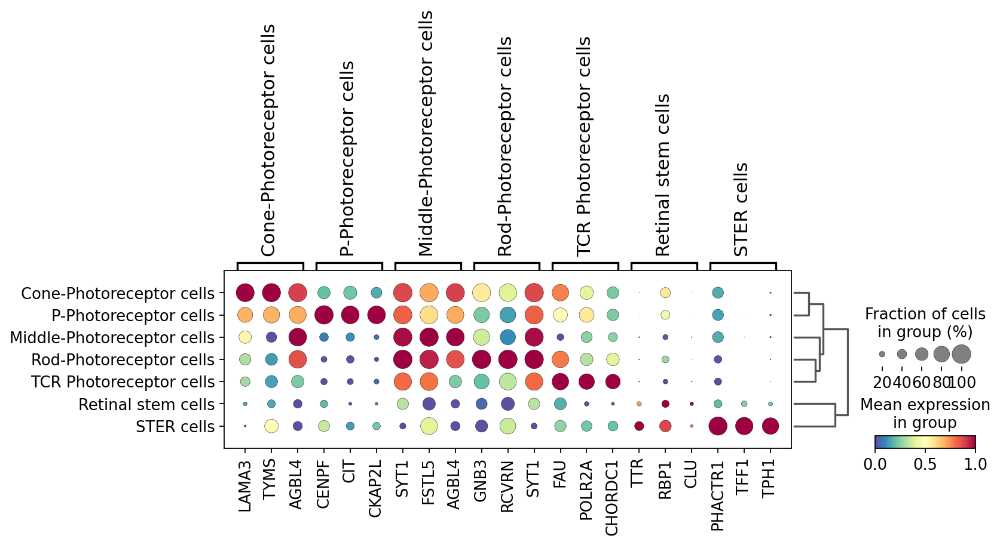

In [332]:
sc.tl.dendrogram(adata,'major_celltype1')
sc.tl.rank_genes_groups(adata, 'major_celltype1', method='t-test',use_raw=False,n_genes=50)
sc.pl.rank_genes_groups_dotplot(adata,groupby='major_celltype1',
                                cmap='Spectral_r',
                                standard_scale='var',n_genes=3)

In [296]:
ax

{'heatmap_ax': <AxesSubplot:>,
 'groupby_ax': <AxesSubplot:xlabel='major_celltype1'>,
 'dendrogram_ax': <AxesSubplot:>,
 'gene_groups_ax': <AxesSubplot:>}

In [317]:
ax['groupby_ax'].get_xticklabels()

[Text(858.0, 0, 'Cone-Photoreceptor cells'),
 Text(2378.5, 0, 'P-Photoreceptor cells'),
 Text(3781.0, 0, 'Middle-Photoreceptor cells'),
 Text(4668.0, 0, 'EDRF1+ Photoreceptor cells'),
 Text(5812.5, 0, 'Rod-Photoreceptor cells'),
 Text(8848.0, 0, 'Retinal stem cells'),
 Text(11862.5, 0, 'STER cells')]

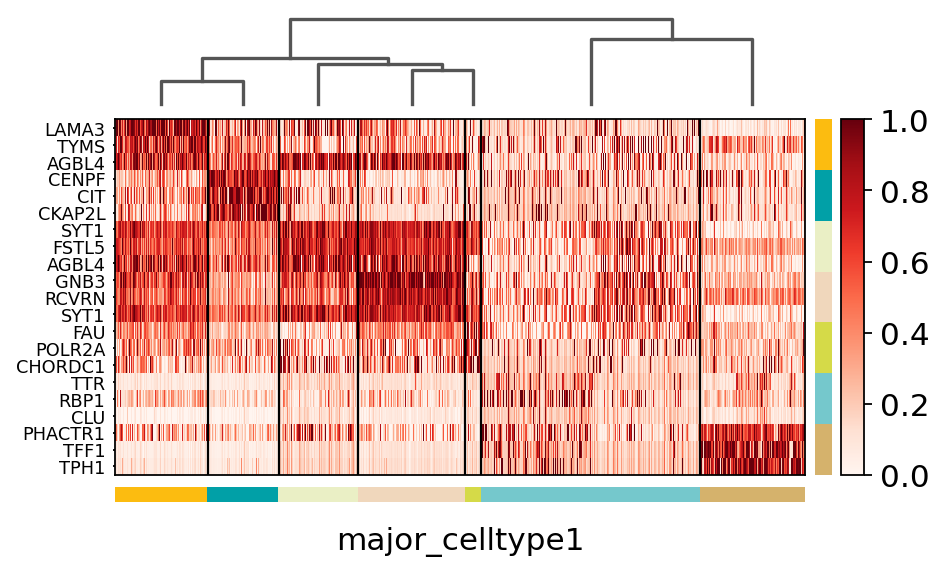

In [403]:
ax=sc.pl.rank_genes_groups_heatmap(adata, n_genes=3, use_raw=False, 
                                swap_axes=True, standard_scale='obs',
                                cmap='Reds',  figsize=(6,4), show=False)
ax['heatmap_ax'].set_yticklabels(ax['heatmap_ax'].get_yticklabels(),fontsize=8)
ax['groupby_ax'].set_xticklabels([])
plt.savefig('result_3/P_marker.png',dpi=300,bbox_inches='tight')

In [393]:
sc.tl.dendrogram(adata,'major_celltype1')

    using 'X_pca' with n_pcs = 100
Storing dendrogram info using `.uns['dendrogram_major_celltype1']`


In [394]:
target_dict_all={}
for ad,name in zip([adata],['RNA']):
    celltype=[(i, 'O') for i in ad.uns['rank_genes_groups']['names'].dtype.names]
    target_dict={}
    target_pd=pd.DataFrame()
    for i in range(len(celltype)):
        cellmarker=[]
        for k in range(50):
            #rank_genes_groups
            cellmarker.append(ad.uns['rank_genes_groups']['names'][k][i])
        #print(cellmarker[0])
        target_pd[celltype[i][0]]=cellmarker
        #ret_target=list(set(cellmarker) & set(rnk_gene))
        target_dict[celltype[i][0]]=cellmarker

    target_dict.keys(),len(cellmarker)
    target_dict_all[name]=target_dict

50

In [ ]:
#cat=Cat1()
from pyVIA.utils_via import *
from pyVIA.plotting_via import *
fig, ax, ax1 = cat.draw_piechart_graph1(adata=adata,clusters='major_celltype1',via_object=v0,ax_text=False)
fig.set_size_inches(6,3)
ax.set_title('Major Trajectory',fontsize=8)
#ax.legend(bbox_to_anchor=(0.5, 0), loc='upper center', borderaxespad=0.,fontsize=8)
ax1.set_title('Pseudotime',fontsize=8)

In [389]:
from pyVIA.utils_via import *
from pyVIA.plotting_via import *
def draw_piechart_graph(adata,clusters,via_object, type_data='pt', gene_exp:list=[], title='', cmap:str=None, ax_text=True, dpi=150,headwidth_arrow = 0.1, alpha_edge=0.4, linewidth_edge=2, edge_color='darkblue',reference=None, show_legend:bool=True, pie_size_scale:float=0.8, fontsize:float=8):
    '''
    plot two subplots with a clustergraph level representation of the viagraph showing true-label composition (lhs) and pseudotime/gene expression (rhs)
    Returns matplotlib figure with two axes that plot the clustergraph using edge bundling
    left axis shows the clustergraph with each node colored by annotated ground truth membership.
    right axis shows the same clustergraph with each node colored by the pseudotime or gene expression
    :param via_object: is class VIA (the same function also exists as a method of the class and an external plotting function
    :param type_data: string  default 'pt' for pseudotime colored nodes. or 'gene'
    :param gene_exp: list of values (column of dataframe) corresponding to feature or gene expression to be used to color nodes at CLUSTER level
    :param title: string
    :param cmap: default None. automatically chooses coolwarm for gene expression or viridis_r for pseudotime
    :param ax_text: Bool default= True. Annotates each node with cluster number and population of membership
    :param dpi: int default = 150
    :param headwidth_bundle: default = 0.1. width of arrowhead used to directed edges
    :param reference: None or list. list of categorical (str) labels for cluster composition of the piecharts (LHS subplot) length = n_samples.
    :param pie_size_scale: float default=0.8 scaling factor of the piechart nodes
    :return: f, ax, ax1
    '''

    from mpl_toolkits.axes_grid1 import make_axes_locatable
    f, ((ax, ax1)) = plt.subplots(1, 2, sharey=True, dpi=dpi)

    node_pos = via_object.graph_node_pos

    node_pos = np.asarray(node_pos)
    if cmap is None: cmap = 'coolwarm' if type_data == 'gene' else 'viridis_r'

    if type_data == 'pt':
        pt = via_object.scaled_hitting_times  # these are the final MCMC refined pt then slightly scaled at cluster level
        title_ax1 = "Pseudotime"

    if type_data == 'gene':
        pt = gene_exp
        title_ax1 = title
    if reference is None: reference_labels=via_object.true_label
    else: reference_labels = reference
    n_groups = len(set(via_object.labels))
    n_truegroups = len(set(reference_labels))
    group_pop = np.zeros([n_groups, 1])
    group_frac = pd.DataFrame(np.zeros([n_groups, n_truegroups]), columns=list(set(reference_labels)))
    via_object.cluster_population_dict = {}
    for group_i in set(via_object.labels):
        loc_i = np.where(via_object.labels == group_i)[0]

        group_pop[group_i] = len(loc_i)  # np.sum(loc_i) / 1000 + 1
        via_object.cluster_population_dict[group_i] = len(loc_i)
        true_label_in_group_i = list(np.asarray(reference_labels)[loc_i])
        for ii in set(true_label_in_group_i):
            group_frac[ii][group_i] = true_label_in_group_i.count(ii)

    line_true = np.linspace(0, 1, n_truegroups)
    color_true_list = [plt.cm.rainbow(color) for color in line_true]
    color_true_list=adata.uns['{}_colors'.format(clusters)]

    sct = ax.scatter(node_pos[:, 0], node_pos[:, 1],
                     c='white', edgecolors='face', s=group_pop, cmap='jet')

    bboxes = getbb(sct, ax)

    ax = plot_edgebundle_viagraph(ax, via_object.hammerbundle_cluster, layout=via_object.graph_node_pos, CSM=via_object.CSM,
                            velocity_weight=via_object.velo_weight, pt=pt, headwidth_bundle=headwidth_arrow,
                            alpha_bundle=alpha_edge,linewidth_bundle=linewidth_edge, edge_color=edge_color)

    trans = ax.transData.transform
    bbox = ax.get_position().get_points()
    ax_x_min = bbox[0, 0]
    ax_x_max = bbox[1, 0]
    ax_y_min = bbox[0, 1]
    ax_y_max = bbox[1, 1]
    ax_len_x = ax_x_max - ax_x_min
    ax_len_y = ax_y_max - ax_y_min
    trans2 = ax.transAxes.inverted().transform
    pie_axs = []
    pie_size_ar = ((group_pop - np.min(group_pop)) / (np.max(group_pop) - np.min(group_pop)) + 0.5) / 10  # 10

    for node_i in range(n_groups):

        cluster_i_loc = np.where(np.asarray(via_object.labels) == node_i)[0]
        majority_true = via_object.func_mode(list(np.asarray(reference_labels)[cluster_i_loc]))
        pie_size = pie_size_ar[node_i][0] *pie_size_scale

        x1, y1 = trans(node_pos[node_i])  # data coordinates
        xa, ya = trans2((x1, y1))  # axis coordinates

        xa = ax_x_min + (xa - pie_size / 2) * ax_len_x
        ya = ax_y_min + (ya - pie_size / 2) * ax_len_y
        # clip, the fruchterman layout sometimes places below figure
        if ya < 0: ya = 0
        if xa < 0: xa = 0
        rect = [xa, ya, pie_size * ax_len_x, pie_size * ax_len_y]
        frac = np.asarray([ff for ff in group_frac.iloc[node_i].values])

        pie_axs.append(plt.axes(rect, frameon=False))
        pie_axs[node_i].pie(frac, wedgeprops={'linewidth': 0.0}, colors=color_true_list)
        pie_axs[node_i].set_xticks([])
        pie_axs[node_i].set_yticks([])
        pie_axs[node_i].set_aspect('equal')
        # pie_axs[node_i].text(0.5, 0.5, graph_node_label[node_i])
        if ax_text==True: pie_axs[node_i].text(0.5, 0.5, majority_true, fontsize = fontsize )

    patches, texts = pie_axs[node_i].pie(frac, wedgeprops={'linewidth': 0.0}, colors=color_true_list)
    labels = list(set(reference_labels))
    if show_legend ==True: plt.legend(patches, labels, loc=(-5, -5), fontsize=6, frameon=False)

    if via_object.time_series==True:
        ti = 'Cluster Composition. K=' + str(via_object.knn) + '. ncomp = ' + str(via_object.ncomp)  +'knnseq_'+str(via_object.knn_sequential)# "+ is_sub
    else:
        ti = 'Cluster Composition. K=' + str(via_object.knn) + '. ncomp = ' + str(via_object.ncomp)
    ax.set_title(ti)
    ax.grid(False)
    ax.set_xticks([])
    ax.set_yticks([])

    title_list = [title_ax1]
    for i, ax_i in enumerate([ax1]):
        pt = via_object.markov_hitting_times if type_data == 'pt' else gene_exp

        c_edge, l_width = [], []
        for ei, pti in enumerate(pt):
            if ei in via_object.terminal_clusters:
                c_edge.append('red')
                l_width.append(1.5)
            else:
                c_edge.append('gray')
                l_width.append(0.0)

        gp_scaling = 1000 / max(group_pop)

        group_pop_scale = group_pop * gp_scaling * 0.5
        ax_i=plot_edgebundle_viagraph(ax_i, via_object.hammerbundle_cluster, layout=via_object.graph_node_pos,CSM=via_object.CSM, velocity_weight=via_object.velo_weight, pt=pt,headwidth_bundle=headwidth_arrow, alpha_bundle=alpha_edge, linewidth_bundle=linewidth_edge, edge_color=edge_color)

        im1 = ax_i.scatter(node_pos[:, 0], node_pos[:, 1], s=group_pop_scale, c=pt, cmap=cmap,
                           edgecolors=c_edge,
                           alpha=1, zorder=3, linewidth=l_width)
        if ax_text:
            x_max_range = np.amax(node_pos[:, 0]) / 100
            y_max_range = np.amax(node_pos[:, 1]) / 100

            for ii in range(node_pos.shape[0]):
                ax_i.text(node_pos[ii, 0] + max(x_max_range, y_max_range),
                          node_pos[ii, 1] + min(x_max_range, y_max_range),
                          'C' + str(ii) + 'pop' + str(int(group_pop[ii][0])),
                          color='black', zorder=4, fontsize = fontsize)
        ax_i.set_title(title_list[i])
        ax_i.grid(False)
        ax_i.set_xticks([])
        ax_i.set_yticks([])

    divider = make_axes_locatable(ax1)
    cax = divider.append_axes('right', size='5%', pad=0.05)
    if type_data == 'pt':
        f.colorbar(im1, cax=cax, orientation='vertical', label='pseudotime',shrink=0.5)
    else:
        f.colorbar(im1, cax=cax, orientation='vertical', label='Gene expression',shrink=0.5)
    f.patch.set_visible(False)

    ax1.axis('off')
    ax.axis('off')
    ax.set_facecolor('white')
    ax1.set_facecolor('white')
    return f, ax, ax1

In [451]:
rna_raw=rna.raw.to_adata()
rna_raw

AnnData object with n_obs × n_vars = 20037 × 37478
    obs: 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'SRR', 'Cancer', 'Tissue', 'Developmental_Stage', 'sample', 'Type', 'n_genes', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'domain', 'leiden', 'SRR1', 'balancing_weight', 'n_counts', 'major_celltype', 'major_celltype_new'
    var: 'gene_ids', 'feature_types', 'genome', 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std', 'chrom', 'chromStart', 'chromEnd', 'name', 'score', 'strand', 'thickStart', 'thickEnd', 'itemRgb', 'blockCount', 'blockSizes', 'blockStarts', 'gene_id', 'gene_type', 'hgnc_id', 'havana_gene', 'tag', 'dell'
    uns: 'Cancer_colors', 'Developmental_Stage_colors', 'SRR1_colors', 'Type_colors', 

In [454]:
rna_raw

AnnData object with n_obs × n_vars = 20037 × 37478
    obs: 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'SRR', 'Cancer', 'Tissue', 'Developmental_Stage', 'sample', 'Type', 'n_genes', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'domain', 'leiden', 'SRR1', 'balancing_weight', 'n_counts', 'major_celltype', 'major_celltype_new'
    var: 'gene_ids', 'feature_types', 'genome', 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std', 'chrom', 'chromStart', 'chromEnd', 'name', 'score', 'strand', 'thickStart', 'thickEnd', 'itemRgb', 'blockCount', 'blockSizes', 'blockStarts', 'gene_id', 'gene_type', 'hgnc_id', 'havana_gene', 'tag', 'dell'
    uns: 'Cancer_colors', 'Developmental_Stage_colors', 'SRR1_colors', 'Type_colors', 

In [455]:
from scipy  import stats,sparse

def scdeg(adata1,adata2):
    mean1=adata1.X.mean(axis=0)
    mean2=adata2.X.mean(axis=0)
    
    if sparse.issparse(adata1.X):
        fold=np.array(adata1.X.mean(axis=0)-adata2.X.mean(axis=0))[0]
        #fold=fold[0]
        #log2fold=np.log2(fold)
        ttest = stats.ttest_ind(adata1[:,:].X.toarray(),adata2[:,:].X.toarray())
    else:
        fold=adata1.X.mean(axis=0)-adata2.X.mean(axis=0)
        #log2fold=np.log2(fold)
        ttest = stats.ttest_ind(adata1[:,:].X,adata2[:,:].X)
    pvalue=ttest.pvalue
    
    res=pd.DataFrame(index=adata1.var.index)
    res['log2FC']=fold
    res['pvalue']=pvalue
    return res

In [459]:
from scipy.stats import ttest_ind
from statsmodels.stats.multitest import fdrcorrection

In [457]:
rna_raw.obs['Developmental_Stage'].unique()

['Retinoblastoma_4months', 'Retinoblastoma_2years']
Categories (2, object): ['Retinoblastoma_2years', 'Retinoblastoma_4months']

In [463]:
deg_r=scdeg(rna_raw[(rna_raw.obs['Developmental_Stage']=='Retinoblastoma_2years')],
            rna_raw[(rna_raw.obs['Developmental_Stage']=='Retinoblastoma_4months')])
deg_r.columns=[i+'-rna' for i in deg_r.columns]
qvalue=fdrcorrection(np.nan_to_num(np.array(deg_r['pvalue-rna']),0), alpha=0.05, method='indep', is_sorted=False)
deg_r['qvalue-rna']=qvalue[1]


,log2FC-rna,pvalue-rna,qvalue-rna,sig
AP006222.2,-0.021638,0.135935,0.220059,normal
CICP18,-0.013514,0.351709,0.458387,normal
AL669831.1,-0.030898,0.033137,0.066423,normal
AC240565.2,0.006770,0.640835,0.720329,normal
AC093752.3,-0.019379,0.181726,0.277354,normal


In [534]:
deg_r['sig-rna']='normal'
deg_r.loc[((deg_r['log2FC-rna']>0.25)&(deg_r['qvalue-rna']<0.05)),'sig-rna']='up'
deg_r.loc[((deg_r['log2FC-rna']<-0.25)&(deg_r['qvalue-rna']<0.05)),'sig-rna']='down'
#deg_r['log(padj)']=-np.log10(qvalue[1]+0.000000001)
deg_r.head()

,log2FC-rna,pvalue-rna,qvalue-rna,sig,log(padj),sig-rna
AP006222.2,-0.021638,0.135935,0.220059,normal,0.657461,normal
CICP18,-0.013514,0.351709,0.458387,normal,0.338768,normal
AL669831.1,-0.030898,0.033137,0.066423,normal,1.177681,normal
AC240565.2,0.006770,0.640835,0.720329,normal,0.142469,normal
AC093752.3,-0.019379,0.181726,0.277354,normal,0.556965,normal


(array([5.000e+00, 2.600e+01, 1.630e+02, 1.231e+03, 2.740e+04, 7.316e+03,
        9.950e+02, 2.470e+02, 7.700e+01, 2.200e+01]),
 array([-1.037, -0.82 , -0.602, -0.384, -0.166,  0.051,  0.269,  0.487,
         0.705,  0.922,  1.14 ], dtype=float32),
 <BarContainer object of 10 artists>)

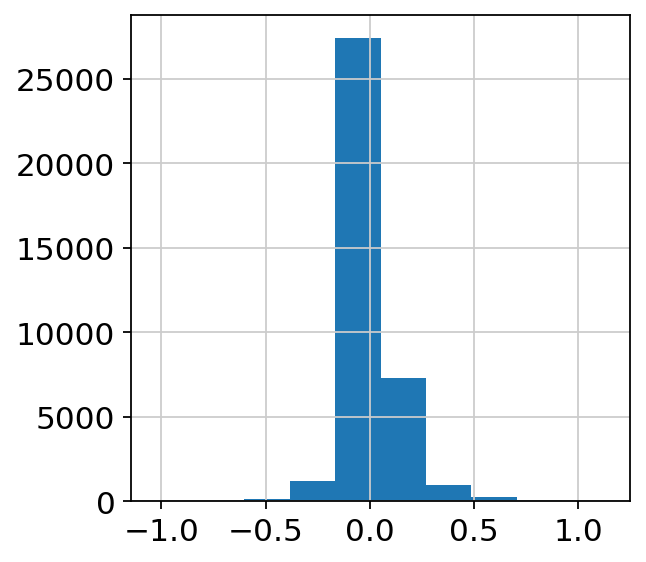

In [462]:
plt.hist(deg_r['log2FC-rna'])

In [469]:
act=sc.read('data/act_anno_new.h5ad')
act

AnnData object with n_obs × n_vars = 21194 × 59454
    obs: 'Tissue', 'Developmental_Stage', 'SRR', 'nb_features', 'log_nb_features', 'domain', 'balancing_weight', 'leiden', 'major_celltype', 'major_celltype_new', 'umap_density_major_celltype_new', 'CD3D'
    uns: 'Developmental_Stage_colors', 'SRR_colors', '__scglue__', 'leiden', 'leiden_colors', 'major_celltype_colors', 'major_celltype_new_colors', 'neighbors', 'umap', 'umap_density_major_celltype_new_params'
    obsm: 'X_glue', 'X_lsi', 'X_umap'
    obsp: 'connectivities', 'distances'

In [ ]:
deg_a=scdeg(act[(act.obs['Developmental_Stage']=='Retinoblastoma_2years')],
            act[(act.obs['Developmental_Stage']=='Retinoblastoma_4months')])
deg_a.columns=[i+'-atac' for i in deg_a.columns]


In [471]:
qvalue=fdrcorrection(np.nan_to_num(np.array(deg_a['pvalue-atac']),0), alpha=0.05, method='indep', is_sorted=False)
deg_a['qvalue-atac']=qvalue[1]
deg_a.head()

,log2FC-atac,pvalue-atac,qvalue-atac
5S_rRNA,0.858063,0.000000e+00,0.000000e+00
5_8S_rRNA,0.021489,1.738583e-29,6.472898e-29
7SK,0.001902,7.279200e-01,7.470911e-01
A1BG,0.327566,0.000000e+00,0.000000e+00
A1BG_AS1,-0.021407,1.590392e-01,1.766593e-01


(-1.0, 1.0)

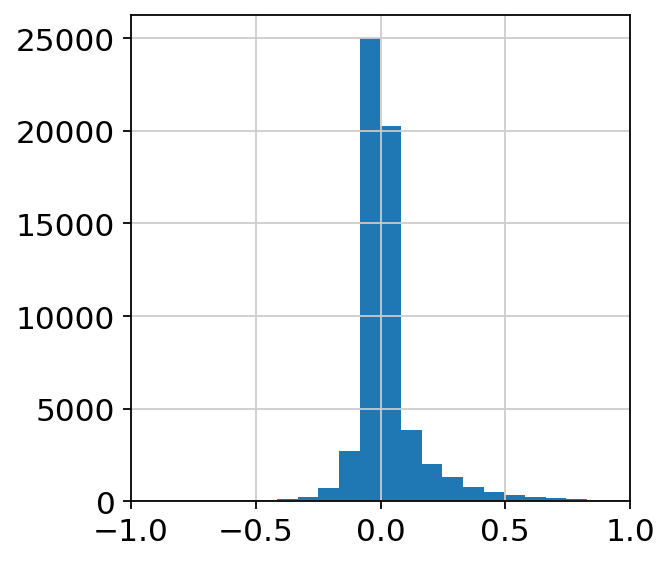

In [477]:
plt.hist(deg_a['log2FC-atac'],bins=1000)
plt.xlim(-1,1)

In [478]:
deg_a['sig-atac']='normal'
deg_a.loc[((deg_a['log2FC-atac']>0.1)&(deg_a['qvalue-atac']<0.05)),'sig-atac']='up'
deg_a.loc[((deg_a['log2FC-atac']<-0.1)&(deg_a['qvalue-atac']<0.05)),'sig-atac']='down'
deg_a['log(padj)']=-np.log10(qvalue[1]+0.000000001)
deg_a.head()

,log2FC-atac,pvalue-atac,qvalue-atac,sig-atac,log(padj)
5S_rRNA,0.858063,0.000000e+00,0.000000e+00,up,9.000000
5_8S_rRNA,0.021489,1.738583e-29,6.472898e-29,normal,9.000000
7SK,0.001902,7.279200e-01,7.470911e-01,normal,0.126626
A1BG,0.327566,0.000000e+00,0.000000e+00,up,9.000000
A1BG_AS1,-0.021407,1.590392e-01,1.766593e-01,normal,0.752863


In [479]:
ret_a_gene=list(set(deg_a.index) & set(deg_r.index))
len(ret_a_gene)

22896

In [535]:
deg_b=pd.concat([deg_r.loc[ret_a_gene],deg_a.loc[ret_a_gene]],join='outer',axis=1)
dif_value=0.25
deg_b['sig']='normal'
deg_b.loc[(deg_b['log2FC-rna']<(0-dif_value)) & (deg_b['log2FC-atac']<-0.1) & (deg_b['qvalue-rna']<0.05) & (deg_b['qvalue-atac']<0.05),'sig']='down-closed'
deg_b.loc[(deg_b['log2FC-rna']>dif_value) & (deg_b['log2FC-atac']>0.1) & (deg_b['qvalue-rna']<0.05) & (deg_b['qvalue-atac']<0.05),'sig']='up-open'

deg_b.loc[(deg_b['log2FC-rna']<(0-dif_value)) & (deg_b['log2FC-atac']>0.1) & (deg_b['qvalue-rna']<0.05) & (deg_b['qvalue-atac']<0.05),'sig']='down-open'
deg_b.loc[(deg_b['log2FC-rna']>dif_value) & (deg_b['log2FC-atac']<-0.1) & (deg_b['qvalue-rna']<0.05) & (deg_b['qvalue-atac']<0.05),'sig']='up-closed'

deg_b.loc[deg_b['sig']!='normal'].head()

,log2FC-rna,pvalue-rna,qvalue-rna,sig,log(padj),sig-rna,log2FC-atac,pvalue-atac,qvalue-atac,sig-atac,log(padj)
CXCL14,-0.254888,0.0,0.0,down-open,9.0,down,0.289202,0.000000e+00,0.000000e+00,up,9.0
STRA6,-0.290292,0.0,0.0,down-closed,9.0,down,-0.150480,2.626692e-16,6.392180e-16,down,9.0
DCT,0.400645,0.0,0.0,up-open,9.0,up,1.425540,0.000000e+00,0.000000e+00,up,9.0
IFT22,-0.416883,0.0,0.0,down-open,9.0,down,0.419996,0.000000e+00,0.000000e+00,up,9.0
SYT1,-1.044798,0.0,0.0,down-closed,9.0,down,-0.281484,7.162942e-38,3.312840e-37,down,9.0


In [536]:
deg_b['abs(log2FC)']=abs(deg_b['log2FC-rna'])
deg_b.head()

,log2FC-rna,pvalue-rna,qvalue-rna,sig,log(padj),sig-rna,log2FC-atac,pvalue-atac,qvalue-atac,sig-atac,log(padj),abs(log2FC)
ENPP7P8,-0.250784,0.000000e+00,0.000000e+00,normal,9.000000,down,-0.041909,1.342074e-14,3.056449e-14,normal,8.999987,0.250784
TFEB,0.080851,2.322600e-08,8.878662e-08,normal,7.046788,normal,0.509104,0.000000e+00,0.000000e+00,up,9.000000,0.080851
BORCS7,0.041585,3.877560e-03,9.333538e-03,normal,2.029954,normal,0.273281,0.000000e+00,0.000000e+00,up,9.000000,0.041585
PPP2R3B,0.011634,4.183568e-01,5.202541e-01,normal,0.283784,normal,0.011760,1.204016e-07,1.982759e-07,normal,6.700545,0.011634
TSPAN15,-0.135229,8.204041e-21,5.234441e-20,normal,9.000000,normal,-0.100099,4.722951e-19,1.274155e-18,down,9.000000,0.135229


In [26]:
deg_b.loc[deg_b['sig']!='normal'].shape

NameError: name 'deg_b' is not defined

log2FC-rna -1.1120776 1.0374671
log2FC-atac -2.7748628 5.795449


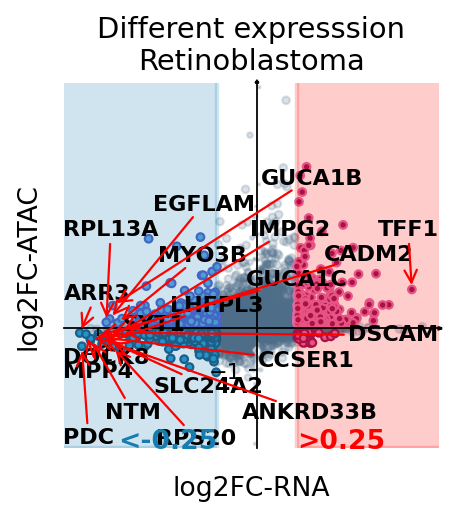

In [525]:
from adjustText import adjust_text
plt.figure(figsize=(3, 3))
plt.scatter(deg_b.loc[deg_b['sig']=='normal']['log2FC-rna'],
            deg_b.loc[deg_b['sig']=='normal']['log2FC-atac'],
            s=-np.log(deg_r.loc[deg_b.loc[deg_b['sig']=='normal'].index]['pvalue-rna']+0.00001),color='#4e6d89',alpha=.2,)

plt.scatter(deg_b.loc[deg_b['sig']=='up-open']['log2FC-rna'],
            deg_b.loc[deg_b['sig']=='up-open']['log2FC-atac'],
            s=-np.log(deg_r.loc[deg_b.loc[deg_b['sig']=='up-open'].index]['pvalue-rna']+0.00001),color=sc_color[15],
           linewidths=1,edgecolors=sc_color[14])

plt.scatter(deg_b.loc[deg_b['sig']=='up-closed']['log2FC-rna'],
            deg_b.loc[deg_b['sig']=='up-closed']['log2FC-atac'],
            s=-np.log(deg_r.loc[deg_b.loc[deg_b['sig']=='up-closed'].index]['pvalue-rna']+0.00001),color=sc_color[14],
           linewidths=1,edgecolors=sc_color[15])

plt.scatter(deg_b.loc[deg_b['sig']=='down-open']['log2FC-rna'],
            deg_b.loc[deg_b['sig']=='down-open']['log2FC-atac'],
            s=-np.log(deg_r.loc[deg_b.loc[deg_b['sig']=='down-open'].index]['pvalue-rna']+0.00001),color='#5ca8dc',
           linewidths=1,edgecolors='#4f61c7')

plt.scatter(deg_b.loc[deg_b['sig']=='down-closed']['log2FC-rna'],
            deg_b.loc[deg_b['sig']=='down-closed']['log2FC-atac'],
            s=-np.log(deg_r.loc[deg_b.loc[deg_b['sig']=='down-closed'].index]['pvalue-rna']+0.00001),color=sc_color[9],
           linewidths=1,edgecolors=sc_color[11])

plot_index=deg_b.loc[deg_b['sig']!='normal'].sort_values('abs(log2FC)',ascending=False).index
texts=[plt.text(deg_b.loc[i,'log2FC-rna'],deg_b.loc[i,'log2FC-atac'],i
        ,fontdict={'size':10,'weight':'bold'}) for i in plot_index[:20]]

adjust_text(texts,only_move={'text': 'xy'},arrowprops=dict(arrowstyle='->', color='red'),)

ax = plt.gca()
# 去掉上、右二侧的边框线
ax.spines['top'].set_color('none')
ax.spines['right'].set_color('none')
 
# 将左侧的y轴，移到x=0的位置
ax.spines['left'].set_position(('data', 0))
ax.spines['bottom'].set_position(('data', 0))
plt.tick_params(labelsize=10)
plt.grid(None)



print('log2FC-rna',deg_b['log2FC-rna'].min(),deg_b['log2FC-rna'].max())
print('log2FC-atac',deg_b['log2FC-atac'].min(),deg_b['log2FC-atac'].max())

plot_xmin=round(deg_b['log2FC-rna'].min(),2)-0.1
plot_xmax=round(deg_b['log2FC-rna'].max(),2)+0.1
plot_ymin=round(deg_b['log2FC-atac'].min(),2)-0.1
plot_ymax=round(deg_b['log2FC-atac'].max(),2)+0.1

plt.xlim(plot_xmin,plot_xmax)
plt.ylim(plot_ymin,plot_ymax)

plt.arrow(0, plot_ymax, 0, 0, width=0.01, color="k", clip_on=False, head_width=0.02, head_length=0.05)
plt.arrow(plot_xmax, 0, 0.001, 0, width=0.01, color="k", clip_on=False, head_width=0.05, head_length=0.02)



plt.gca().add_patch(plt.Rectangle(xy=(0.25,plot_ymin),
width=15, color='red',
height=10,alpha=.2,
fill=True, linewidth=2))

plt.gca().add_patch(plt.Rectangle(xy=(-0.25,plot_ymin),
width=-15, color='#177cb0',
height=10,alpha=.2,
fill=True, linewidth=2))

ax.set_ylabel('log2FC-ATAC', ha='left', y=2, rotation=90, labelpad=75)
ax.set_xlabel('log2FC-RNA', ha='left', y=0, rotation=0, labelpad=50)
plt.text(0.25,plot_ymin,'>0.25',fontsize=12,color='red',fontweight='bold')
plt.text(-0.25,plot_ymin,'<-0.25',fontsize=12,color='#177cb0',ha='right',fontweight='bold')

plt.xlabel('log2FC-RNA',fontsize=12,)
plt.ylabel('log2FC-ATAC',fontsize=12,)
plt.title('Different expresssion\nRetinoblastoma',fontsize=13)

plt.yticks(np.linspace(-1, 0.5, 1))
plt.xticks(np.linspace(-1, 0.5, 1))

plt.savefig("result_3/deg_Retinoblastoma.png",dpi=300,bbox_inches = 'tight')

In [537]:
deg_b.loc[deg_b['sig-rna']=='down'].index

Index(['ENPP7P8', 'KRBOX1', 'CXCL14', 'STRA6', 'C19orf48', 'IFT22', 'MAP6',
       'SYT1', 'PTK2', 'DNAJA4',
       ...
       'ZNRF3', 'GAD1', 'ATP11A', 'ATP1B1', 'TPP2', 'RPL27A', 'CASP8AP2',
       'KREMEN2', 'IER5L', 'UBL3'],
      dtype='object', length=1355)

In [531]:
sc.tl.dendrogram(adata,'major_celltype1')
adata.uns['log1p']['base']=None
sc.tl.rank_genes_groups(adata, 'major_celltype1', method='t-test',use_raw=False,n_genes=50)
target_dict_all={}
for ad,name in zip([adata],['RNA']):
    celltype=[(i, 'O') for i in ad.uns['rank_genes_groups']['names'].dtype.names]
    target_dict={}
    target_pd=pd.DataFrame()
    for i in range(len(celltype)):
        cellmarker=[]
        for k in range(10):
            #rank_genes_groups
            cellmarker.append(ad.uns['rank_genes_groups']['names'][k][i])
        #print(cellmarker[0])
        target_pd[celltype[i][0]]=cellmarker
        #ret_target=list(set(cellmarker) & set(rnk_gene))
        target_dict[celltype[i][0]]=cellmarker

    target_dict.keys(),len(cellmarker)
    target_dict_all[name]=target_dict

    using 'X_pca' with n_pcs = 100
Storing dendrogram info using `.uns['dendrogram_major_celltype1']`
ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


In [541]:
for celltype in target_dict_all['RNA'].keys():
    ret_g=list(set(deg_b.loc[deg_b['sig']=='down-closed'].index) & set(target_dict_all['RNA'][celltype]))
    print(celltype,ret_g)

Cone-Photoreceptor cells ['SLC8A1', 'SYT1', 'LAMA3']
Middle-Photoreceptor cells ['SLC8A1', 'SYT1']
P-Photoreceptor cells []
Retinal stem cells []
Rod-Photoreceptor cells ['SLC8A1', 'SYT1']
STER cells []
TCR Photoreceptor cells ['TAFA4']


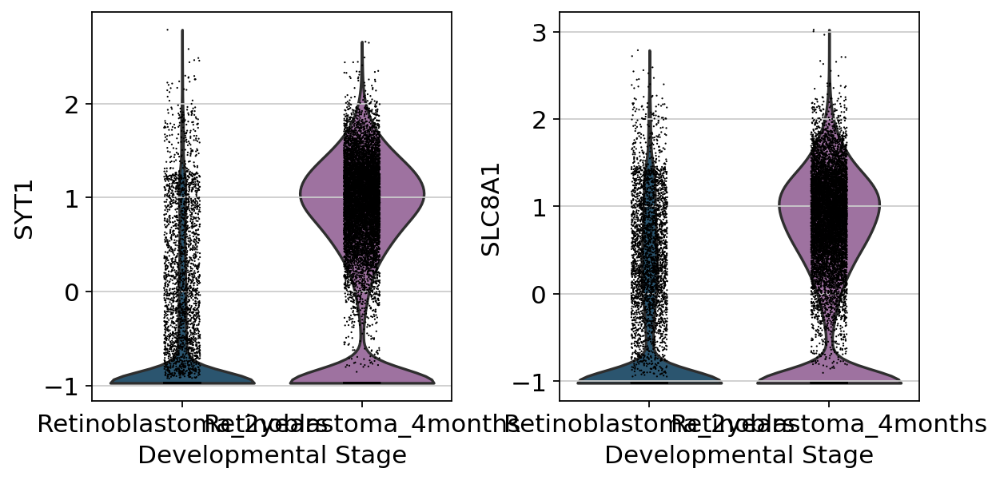

In [546]:
sc.pl.violin(rna_raw, ['SYT1', 'SLC8A1'], groupby='Developmental_Stage' )

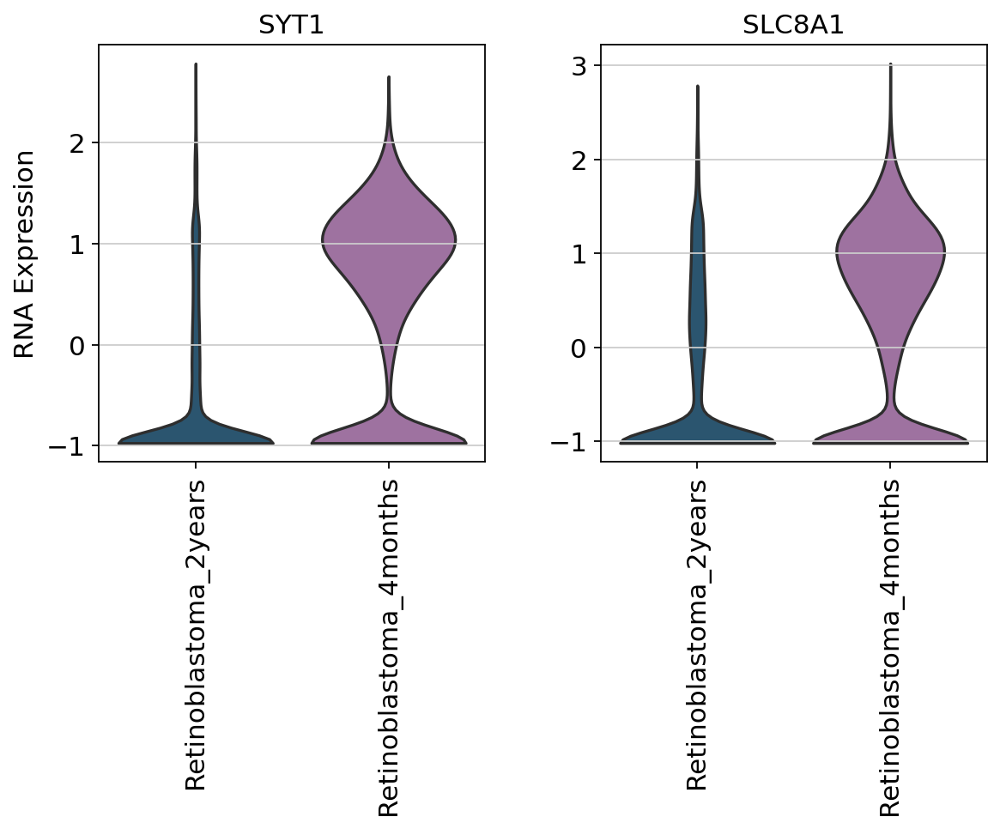

In [557]:
ax=sc.pl.violin(rna_raw, ['SYT1','SLC8A1'], groupby='Developmental_Stage',fig_size=(2,2),
             stripplot=False, jitter=0.2, multi_panel=False,show=False)
ax[0].set_xticklabels(ax[0].get_xticklabels(),rotation=90)
ax[0].set_xlabel('')
ax[0].set_title('SYT1')
ax[0].set_ylabel('RNA Expression')
ax[1].set_xticklabels(ax[1].get_xticklabels(),rotation=90)
ax[1].set_xlabel('')
ax[1].set_ylabel('')
ax[1].set_title('SLC8A1')
plt.savefig('result_3/rna_violin.png',dpi=300,bbox_inches='tight')

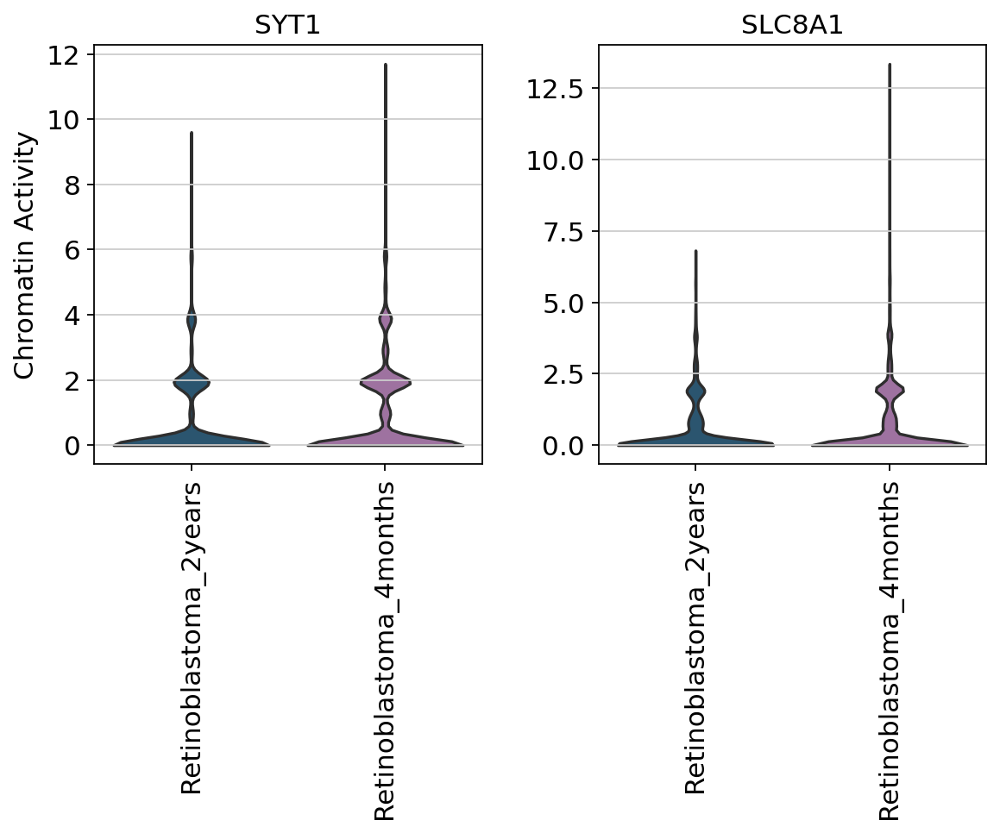

In [558]:
ax=sc.pl.violin(act, ['SYT1','SLC8A1'], groupby='Developmental_Stage',fig_size=(2,2),
             stripplot=False, jitter=0.2, multi_panel=False,show=False,)
ax[0].set_xticklabels(ax[0].get_xticklabels(),rotation=90)
ax[0].set_xlabel('')
ax[0].set_title('SYT1')
ax[0].set_ylabel('Chromatin Activity')
ax[1].set_xticklabels(ax[1].get_xticklabels(),rotation=90)
ax[1].set_xlabel('')
ax[1].set_ylabel('')
ax[1].set_title('SLC8A1')
plt.savefig('result_3/act_violin.png',dpi=300,bbox_inches='tight')

In [25]:
adata.obs

,initial_size_spliced,initial_size_unspliced,initial_size,SRR,Cancer,Tissue,Developmental_Stage,sample,Type,n_genes,...,n_counts,major_celltype,major_celltype_new,velocity_self_transition,root_cells,end_points,velocity_pseudotime,latent_time,pt,major_celltype1
AAACCCATCGTAACAC-SRR13633759,177,331,177.0,SRR13633759,RB,Retinoblastoma,Retinoblastoma_4months,RB-SRR13633759,paracarcinoma,517,...,-288.798096,Photoreceptor progenitor cell,P-Photoreceptor cells,0.489886,0.237223,9.534518e-05,0.951751,0.242054,0.157259,Retinal stem cells
AAACGCTAGAAATCCA-SRR13633759,192,302,192.0,SRR13633759,RB,Retinoblastoma,Retinoblastoma_4months,RB-SRR13633759,paracarcinoma,506,...,-363.343231,Photoreceptor progenitor cell,P-Photoreceptor cells,0.306581,0.046902,1.548957e-05,0.951347,0.222173,0.157259,Retinal stem cells
AAACGCTTCCAGCCTT-SRR13633759,220,354,220.0,SRR13633759,RB,Retinoblastoma,Retinoblastoma_4months,RB-SRR13633759,paracarcinoma,567,...,-295.936035,Photoreceptor progenitor cell,P-Photoreceptor cells,0.092708,0.036095,8.749544e-05,0.956883,0.165259,0.157259,Retinal stem cells
AAAGGGCTCCCGAACG-SRR13633759,258,203,258.0,SRR13633759,RB,Retinoblastoma,Retinoblastoma_4months,RB-SRR13633759,paracarcinoma,471,...,-378.000519,Photoreceptor progenitor cell,P-Photoreceptor cells,0.370328,0.006571,2.838443e-04,0.954348,0.184623,0.157259,Retinal stem cells
AAAGGTAAGGAACGCT-SRR13633759,185,235,185.0,SRR13633759,RB,Retinoblastoma,Retinoblastoma_4months,RB-SRR13633759,paracarcinoma,445,...,-215.978378,Photoreceptor cells,Photoreceptor cells,0.524956,0.520533,2.268820e-06,0.955985,0.207381,0.157259,Retinal stem cells
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGAGAAGCTCG-SRR13633762,13052,7192,13052.0,SRR13633762,RB,Retinoblastoma,Retinoblastoma_2years,RB-SRR13633762,carcinoma,6331,...,306.263153,STER cells,STER cells,0.472004,0.012212,6.535770e-04,0.966135,0.301935,0.404496,STER cells
TTTGTTGCAGGGAATC-SRR13633762,18240,23191,18240.0,SRR13633762,RB,Retinoblastoma,Retinoblastoma_2years,RB-SRR13633762,carcinoma,8722,...,365.244934,STER cells,STER cells,0.121258,0.011829,1.602120e-02,0.952977,0.159876,0.265038,STER cells
TTTGTTGGTCCACGCA-SRR13633762,273,215,273.0,SRR13633762,RB,Retinoblastoma,Retinoblastoma_2years,RB-SRR13633762,carcinoma,522,...,-313.365570,Retinal stem cells,Retinal stem cells,0.338084,0.438560,1.977609e-05,0.947449,0.279338,0.223191,Retinal stem cells
TTTGTTGTCGAGAGAC-SRR13633762,1356,281,1356.0,SRR13633762,RB,Retinoblastoma,Retinoblastoma_2years,RB-SRR13633762,carcinoma,1428,...,38.691795,STER cells,STER cells,0.583704,0.211384,4.953426e-02,0.979338,0.170874,0.209563,STER cells
